# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [11]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [12]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [13]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [14]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels)
    #### END CODE HERE ####

In [15]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
# Check that the device of get_one_hot_labels matches the input device
if torch.cuda.is_available():
    assert str(get_one_hot_labels(torch.Tensor([[0]]).long().cuda(), 1).device).startswith("cuda")
    
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [16]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat([x.float(), y.float()], dim = 1)
    #### END CODE HERE ####
    return combined

In [17]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]))
if torch.cuda.is_available():
    # Check that it doesn't break with cuda
    cuda_check = combine_vectors(torch.tensor([[1, 2], [3, 4]]).cuda(), torch.tensor([[5, 6], [7, 8]]).cuda())
    assert str(cuda_check.device).startswith("cuda")
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
# Check that the float transformation doesn't happen after the inputs are concatenated
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12)).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [18]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [19]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [20]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [21]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [22]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Epoch 1, step 500: Generator loss: 2.3043841292858125, discriminator loss: 0.23471519512310624


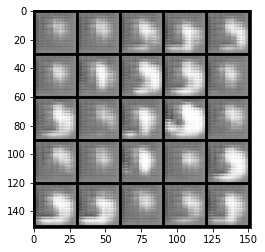

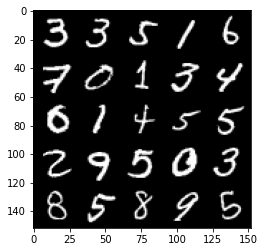

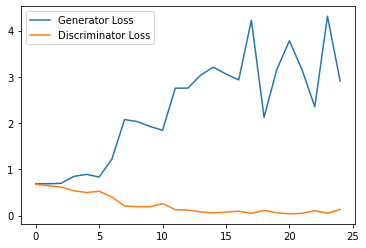

Epoch 2, step 1000: Generator loss: 4.8711982703208925, discriminator loss: 0.05460716532636434


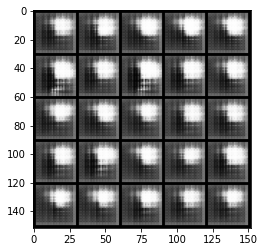

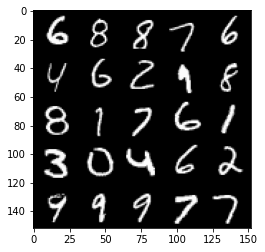

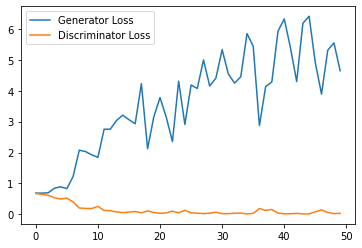

Epoch 3, step 1500: Generator loss: 5.643597232818603, discriminator loss: 0.03399647615198046


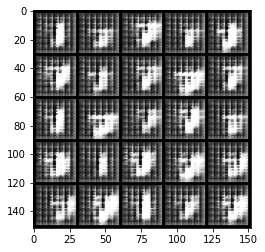

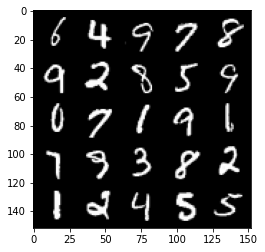

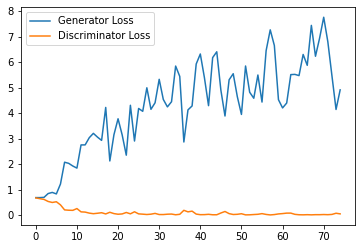

Epoch 4, step 2000: Generator loss: 4.399404637336731, discriminator loss: 0.060231038331985474


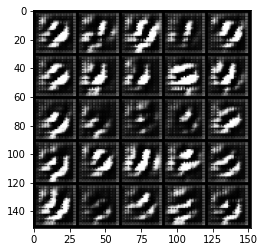

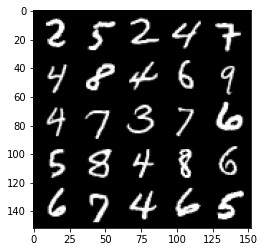

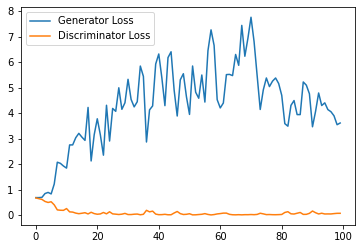

Epoch 5, step 2500: Generator loss: 4.08075005197525, discriminator loss: 0.08230954381451011


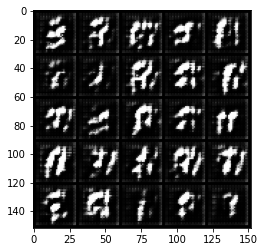

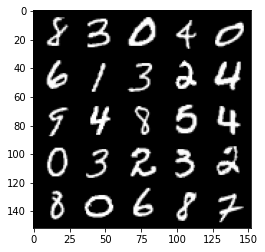

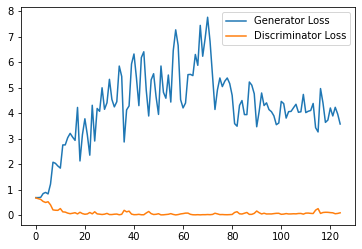

Epoch 6, step 3000: Generator loss: 3.5393337869644164, discriminator loss: 0.13772508081048726


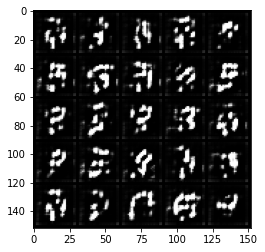

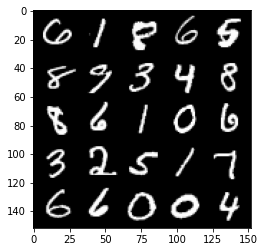

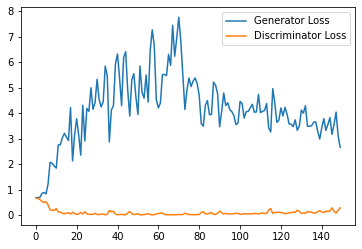

Epoch 7, step 3500: Generator loss: 2.706465136766434, discriminator loss: 0.24470666851103307


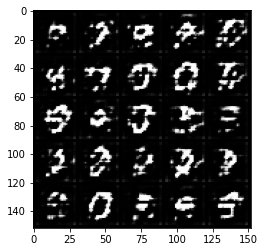

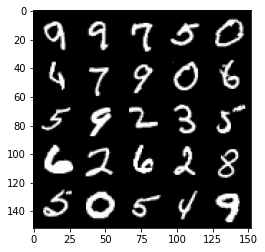

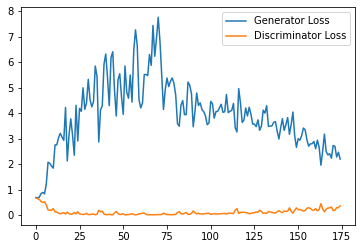

Epoch 8, step 4000: Generator loss: 2.506008594751358, discriminator loss: 0.27269183441996575


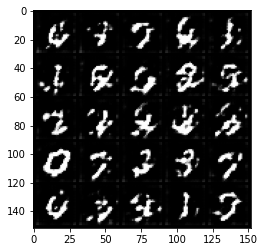

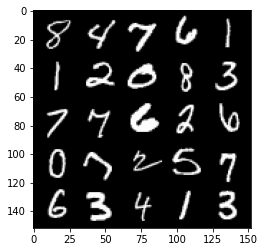

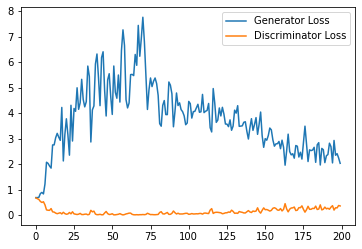

Epoch 9, step 4500: Generator loss: 2.222659190416336, discriminator loss: 0.27238833823800085


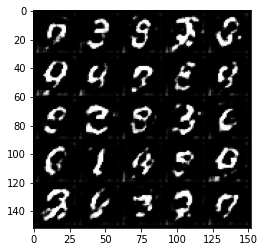

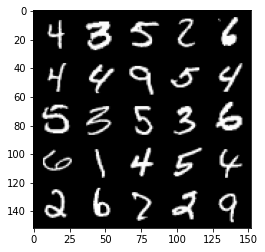

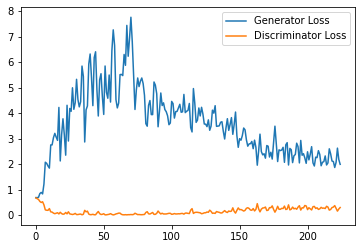

Epoch 10, step 5000: Generator loss: 2.1993924586772917, discriminator loss: 0.3081345157176256


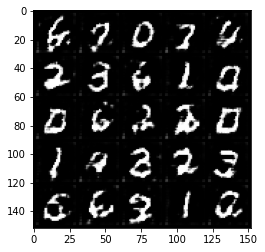

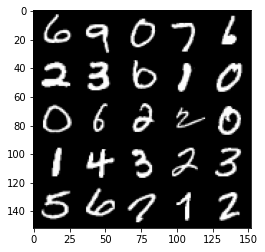

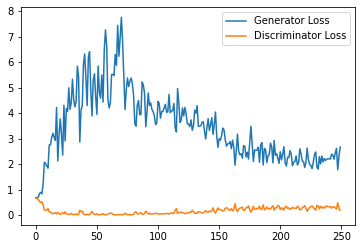

Epoch 11, step 5500: Generator loss: 2.271900829076767, discriminator loss: 0.3063693655133247


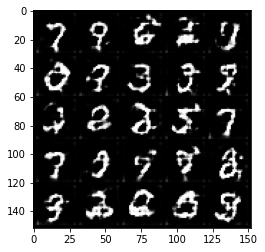

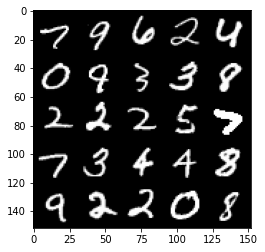

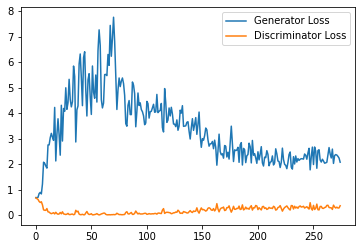

Epoch 12, step 6000: Generator loss: 2.0108316428661346, discriminator loss: 0.34975952956080436


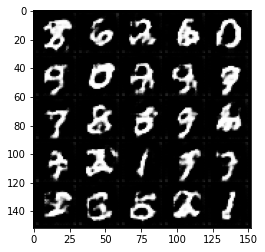

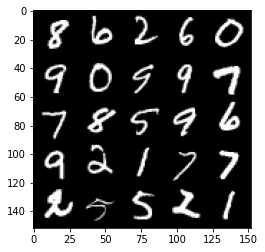

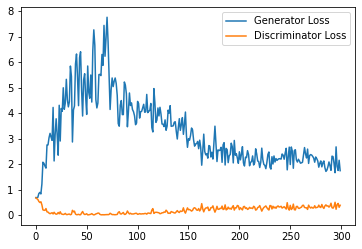

Epoch 13, step 6500: Generator loss: 1.8437287690639497, discriminator loss: 0.3707730648815632


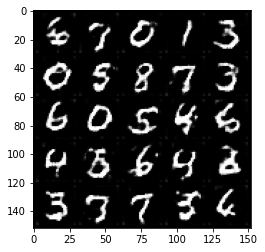

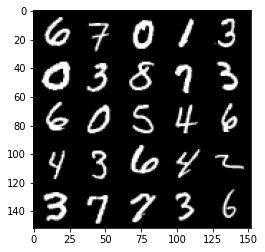

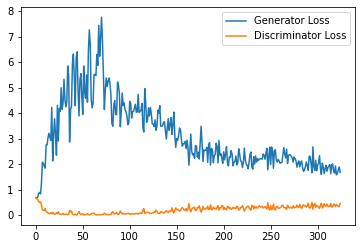

Epoch 14, step 7000: Generator loss: 1.716569270849228, discriminator loss: 0.3937537968456745


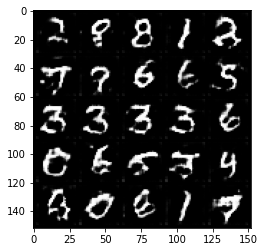

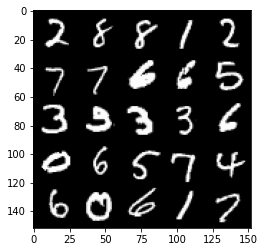

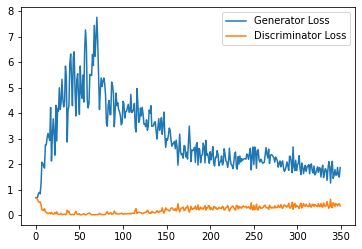

Epoch 15, step 7500: Generator loss: 1.608976521730423, discriminator loss: 0.42817714050412176


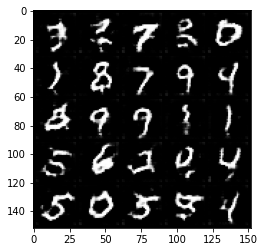

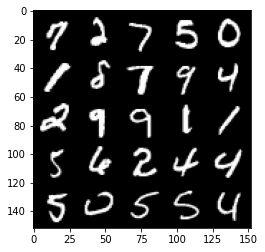

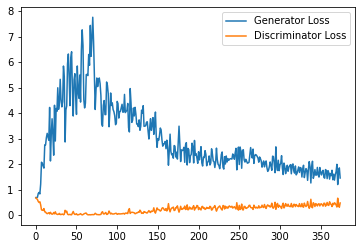

Epoch 17, step 8000: Generator loss: 1.6261969394683837, discriminator loss: 0.45182000344991685


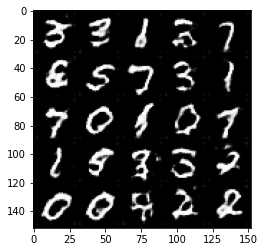

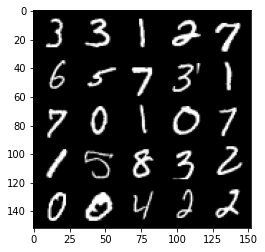

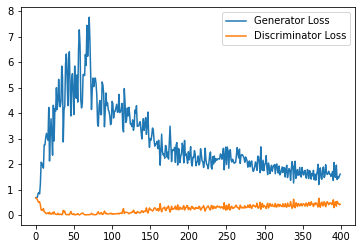

Epoch 18, step 8500: Generator loss: 1.4503898264169692, discriminator loss: 0.4801289885640144


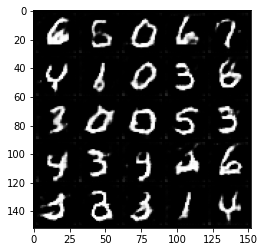

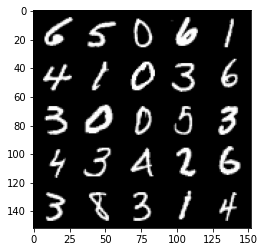

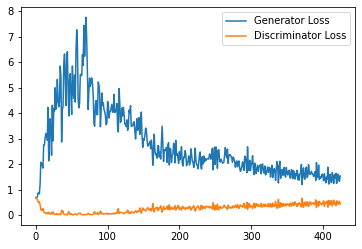

Epoch 19, step 9000: Generator loss: 1.4740249301195145, discriminator loss: 0.4904057460427284


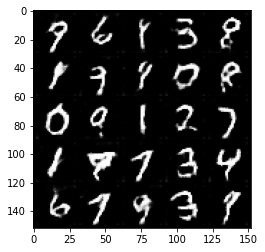

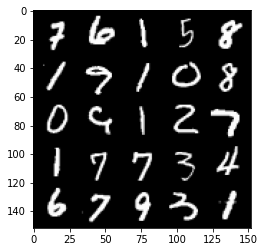

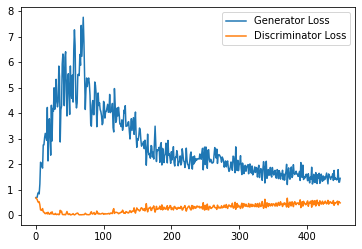

Epoch 20, step 9500: Generator loss: 1.3516186079978942, discriminator loss: 0.5027763119339943


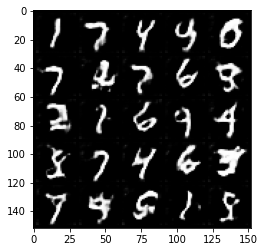

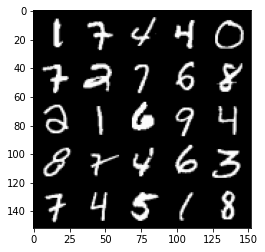

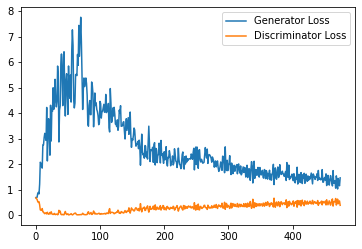

Epoch 21, step 10000: Generator loss: 1.2782841347455978, discriminator loss: 0.52376340842247


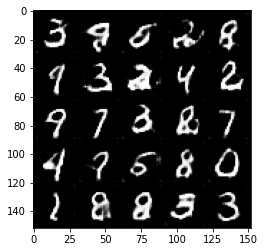

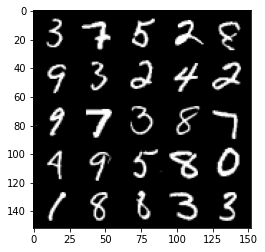

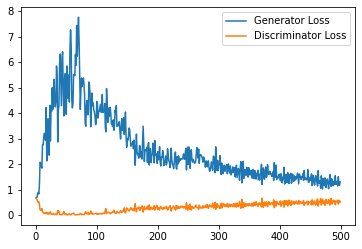

Epoch 22, step 10500: Generator loss: 1.2473397439718246, discriminator loss: 0.5319047387242317


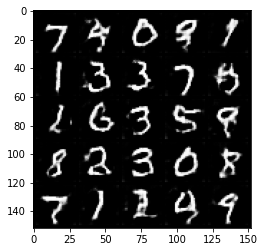

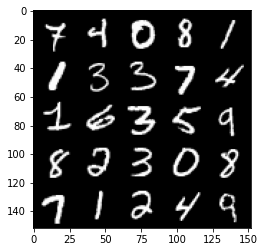

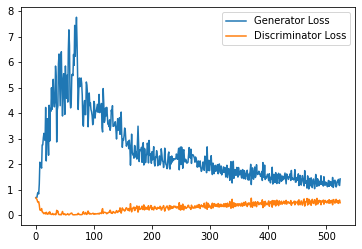

Epoch 23, step 11000: Generator loss: 1.2512911585569382, discriminator loss: 0.5379192332625389


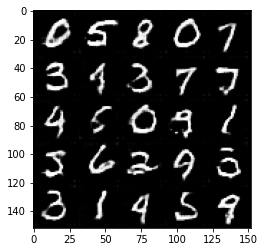

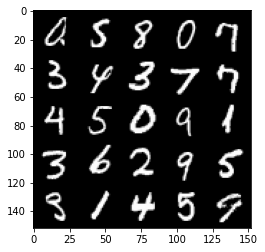

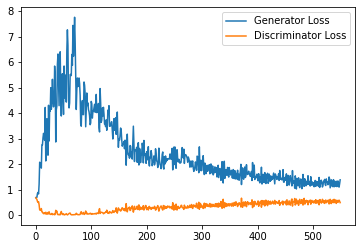

Epoch 24, step 11500: Generator loss: 1.2256679235696792, discriminator loss: 0.5516161774992943


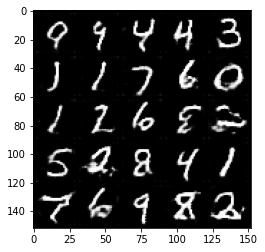

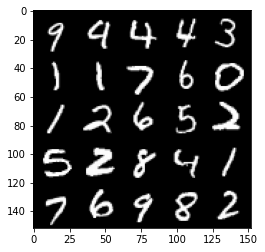

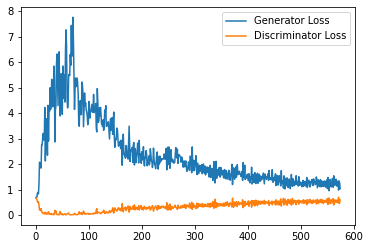

Epoch 25, step 12000: Generator loss: 1.1516204332113267, discriminator loss: 0.5535538340806961


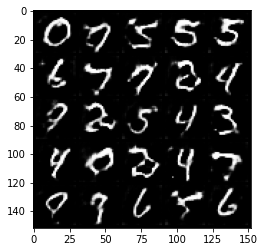

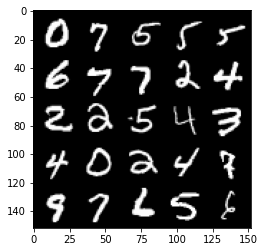

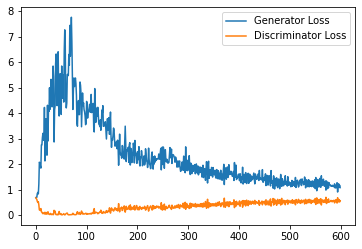

Epoch 26, step 12500: Generator loss: 1.1729885691404343, discriminator loss: 0.5557640374302865


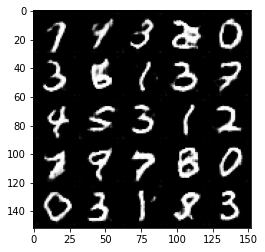

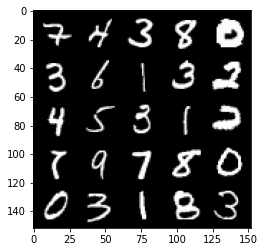

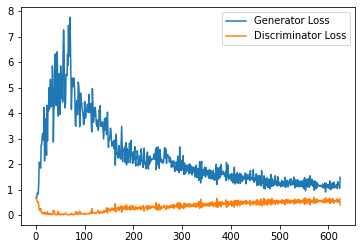

Epoch 27, step 13000: Generator loss: 1.1797040820121765, discriminator loss: 0.5642093534469604


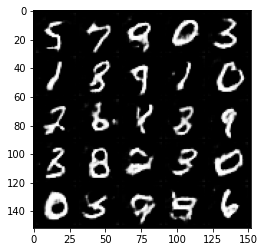

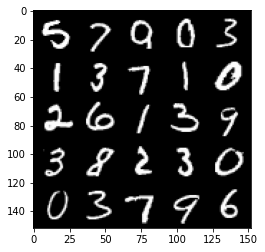

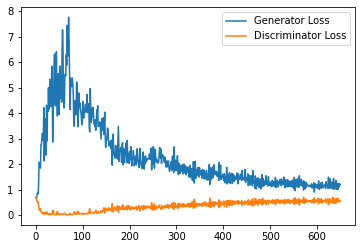

Epoch 28, step 13500: Generator loss: 1.169422986984253, discriminator loss: 0.5684593067765236


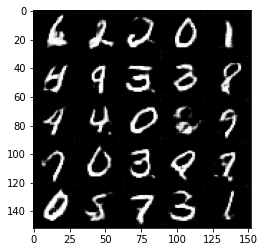

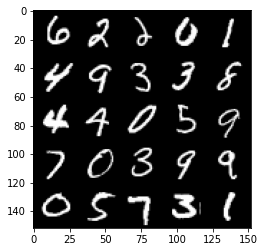

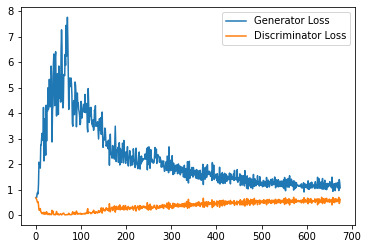

Epoch 29, step 14000: Generator loss: 1.179349895834923, discriminator loss: 0.5706455382704735


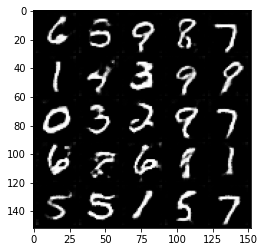

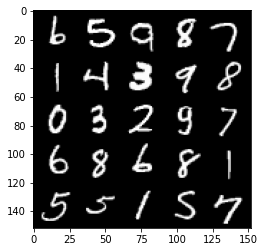

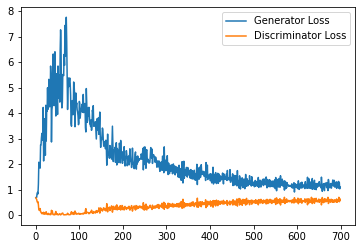

Epoch 30, step 14500: Generator loss: 1.1264504634141923, discriminator loss: 0.5652829755544663


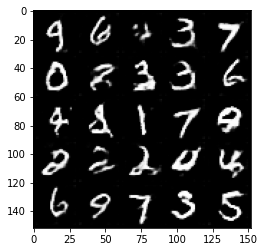

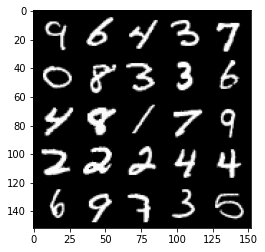

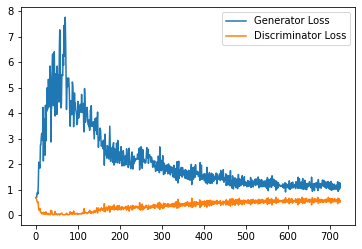

Epoch 31, step 15000: Generator loss: 1.0941009027957915, discriminator loss: 0.5675200846791267


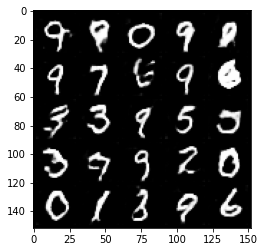

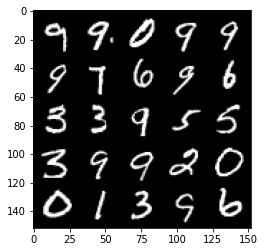

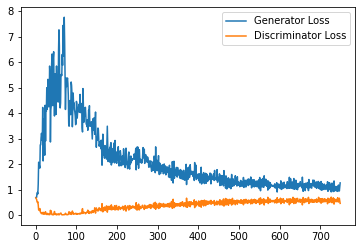

Epoch 33, step 15500: Generator loss: 1.1064008872509004, discriminator loss: 0.5715162427425384


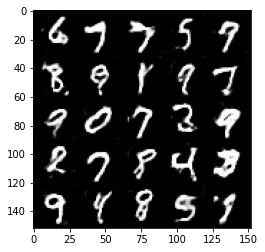

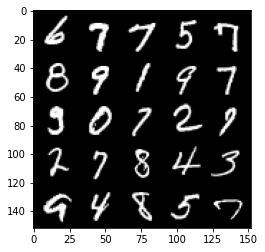

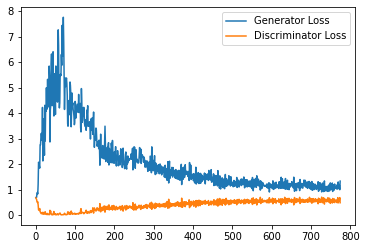

Epoch 34, step 16000: Generator loss: 1.0846130205392837, discriminator loss: 0.5713262179493904


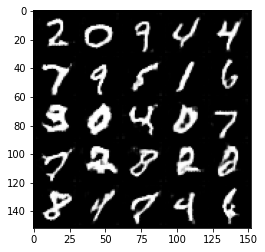

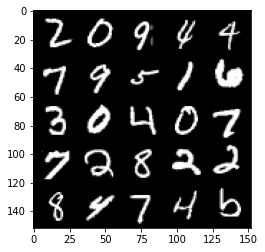

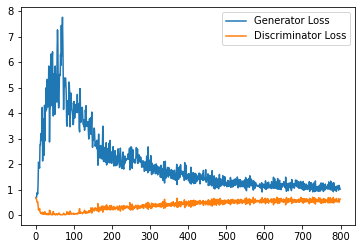

Epoch 35, step 16500: Generator loss: 1.084628945708275, discriminator loss: 0.5686051752567292


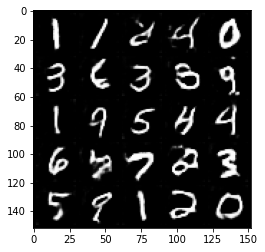

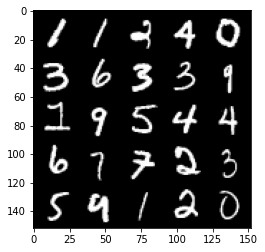

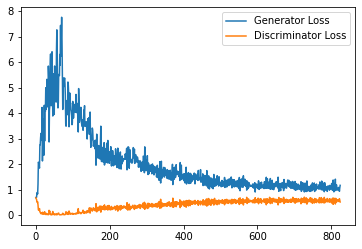

Epoch 36, step 17000: Generator loss: 1.0693616546392442, discriminator loss: 0.5731146287918091


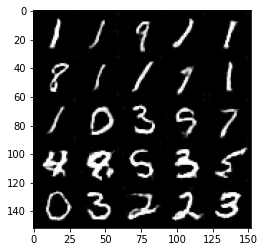

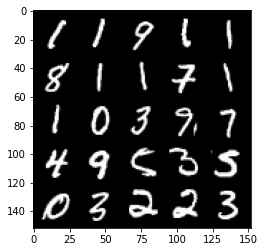

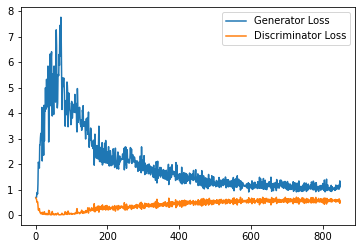

Epoch 37, step 17500: Generator loss: 1.0912095668315887, discriminator loss: 0.5771049459576607


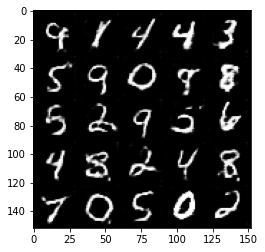

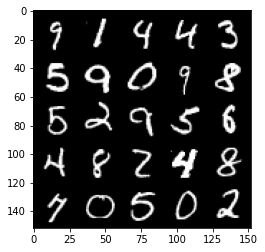

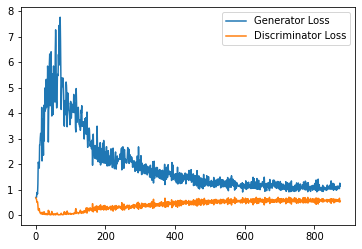

Epoch 38, step 18000: Generator loss: 1.0887126754522323, discriminator loss: 0.5830263248682022


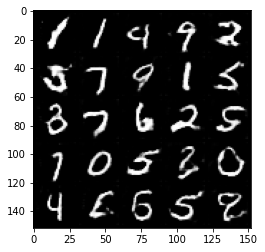

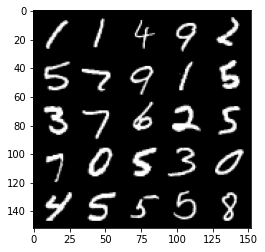

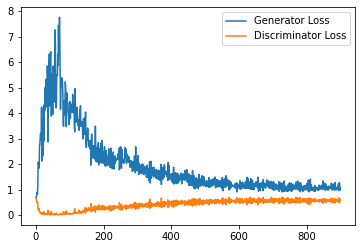

Epoch 39, step 18500: Generator loss: 1.0505766489505768, discriminator loss: 0.579189719080925


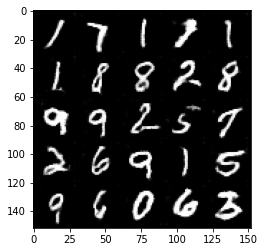

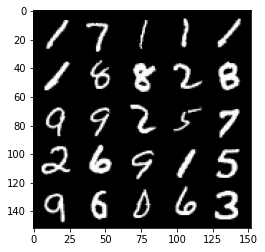

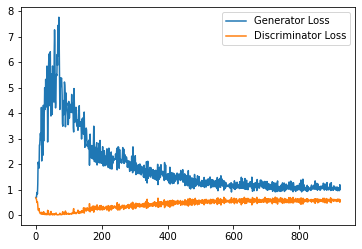

Epoch 40, step 19000: Generator loss: 1.0430176166296006, discriminator loss: 0.5743510124087333


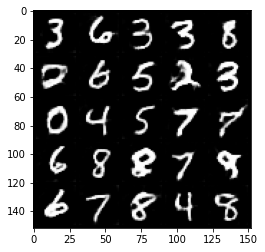

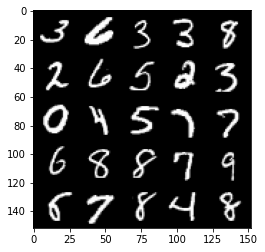

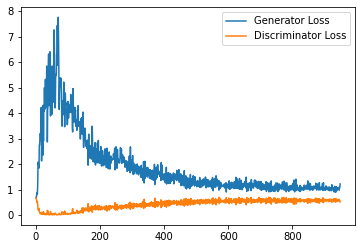

Epoch 41, step 19500: Generator loss: 1.046215497970581, discriminator loss: 0.5864286019206048


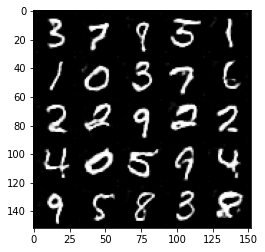

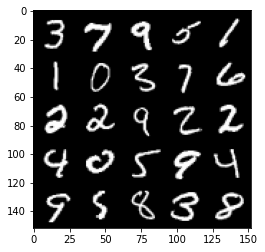

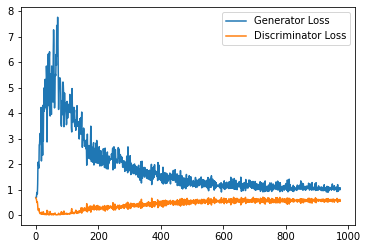

Epoch 42, step 20000: Generator loss: 1.0558002835512161, discriminator loss: 0.5873611994385719


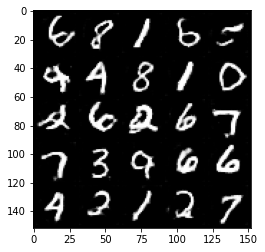

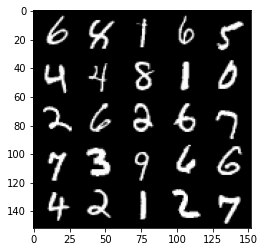

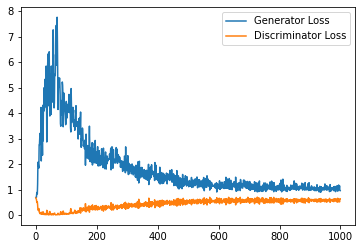

Epoch 43, step 20500: Generator loss: 1.0693451020717621, discriminator loss: 0.5858210029602051


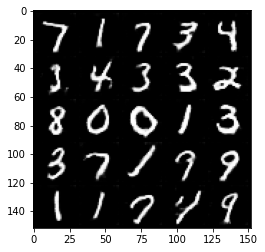

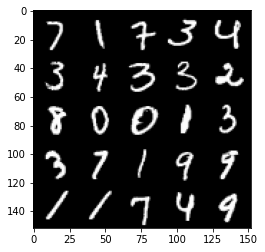

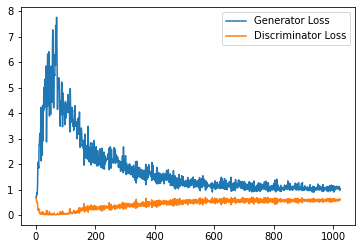

Epoch 44, step 21000: Generator loss: 1.057387400507927, discriminator loss: 0.588826421558857


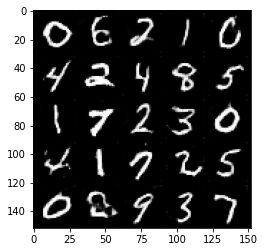

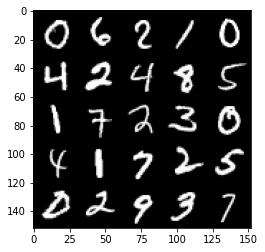

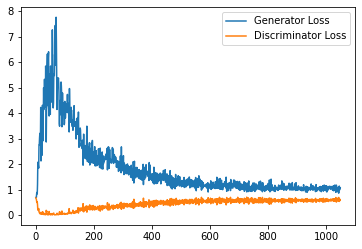

Epoch 45, step 21500: Generator loss: 1.0198599178791046, discriminator loss: 0.5877669021487236


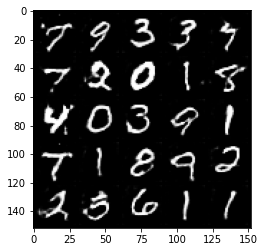

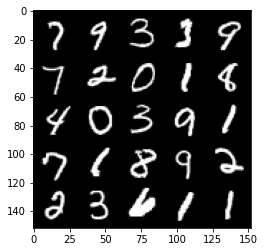

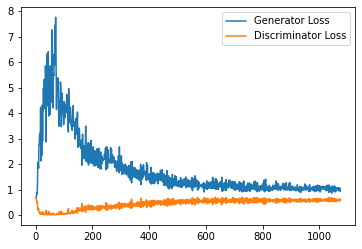

Epoch 46, step 22000: Generator loss: 1.0212481112480163, discriminator loss: 0.5957170574069023


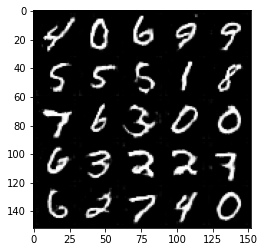

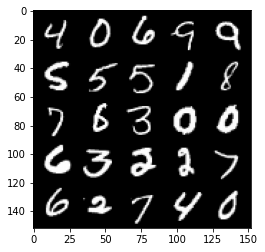

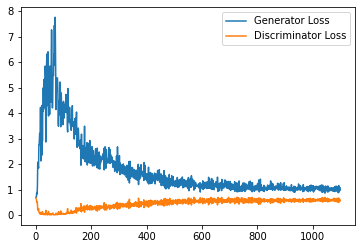

Epoch 47, step 22500: Generator loss: 1.0303198547363281, discriminator loss: 0.5956792942285538


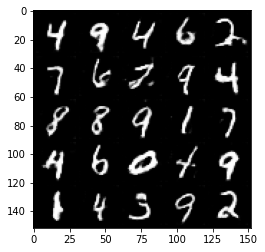

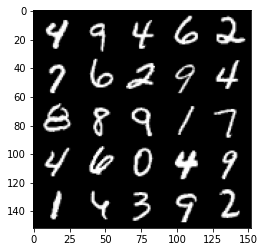

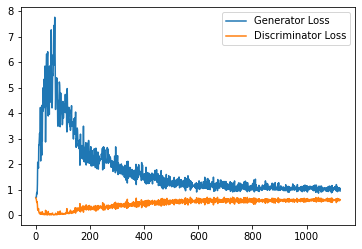

Epoch 49, step 23000: Generator loss: 1.01834017598629, discriminator loss: 0.5901018252968788


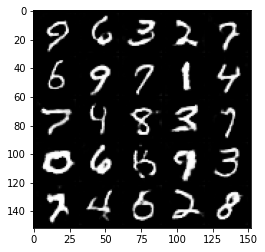

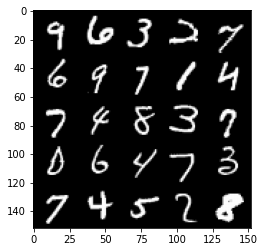

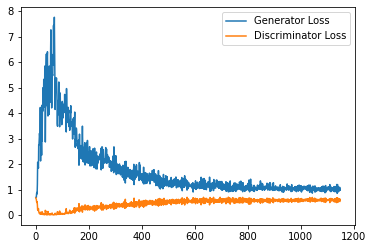

Epoch 50, step 23500: Generator loss: 1.0230581809282302, discriminator loss: 0.5966234957575798


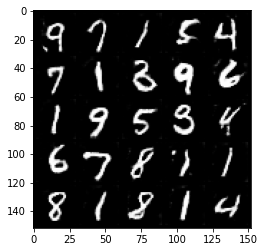

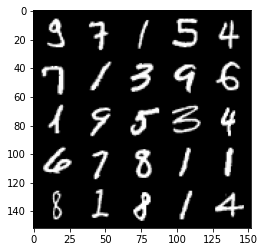

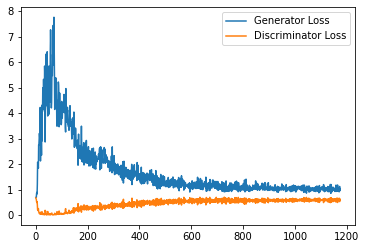

Epoch 51, step 24000: Generator loss: 1.0261322178840637, discriminator loss: 0.6005850391983986


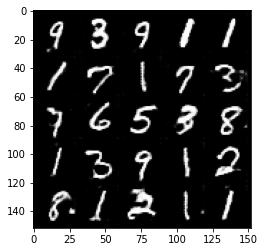

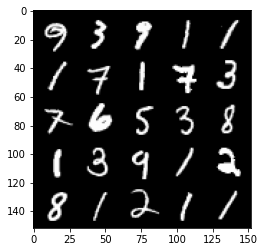

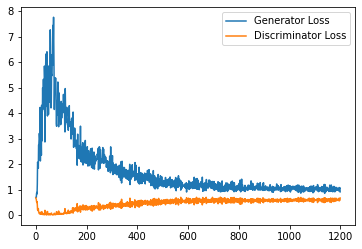

Epoch 52, step 24500: Generator loss: 1.0261351417303086, discriminator loss: 0.5928561882972717


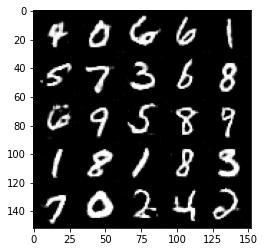

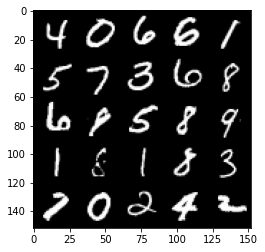

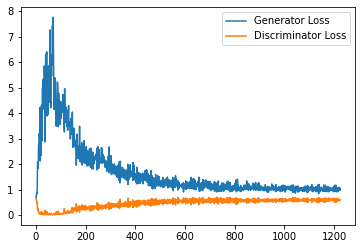

Epoch 53, step 25000: Generator loss: 1.0267554144859314, discriminator loss: 0.5938072671890259


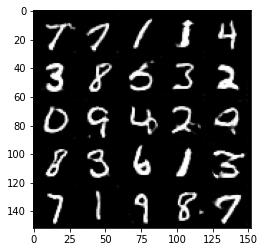

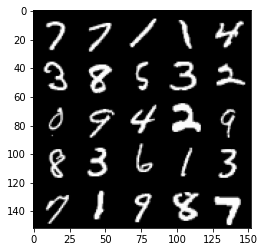

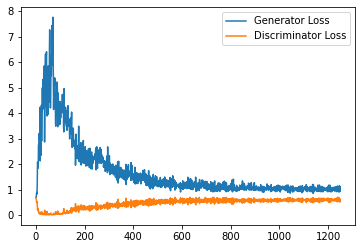

Epoch 54, step 25500: Generator loss: 1.0091487979888916, discriminator loss: 0.5967262712717056


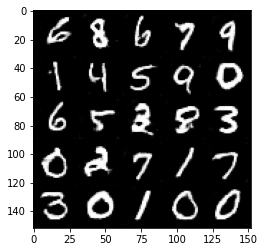

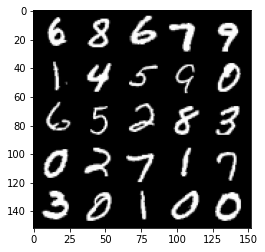

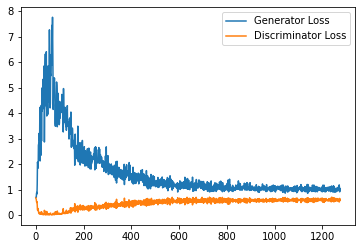

Epoch 55, step 26000: Generator loss: 1.0194668498039245, discriminator loss: 0.5987993184328079


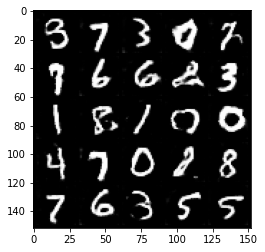

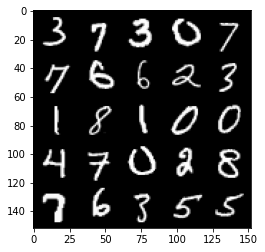

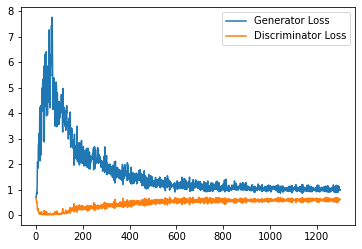

Epoch 56, step 26500: Generator loss: 0.9926434891223908, discriminator loss: 0.6005229297876358


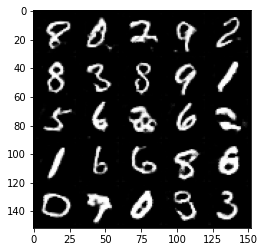

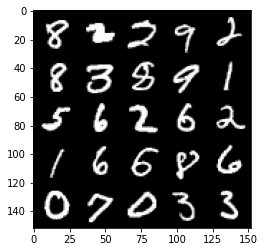

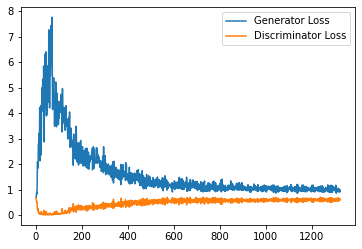

Epoch 57, step 27000: Generator loss: 0.9703084723949432, discriminator loss: 0.6016491922140121


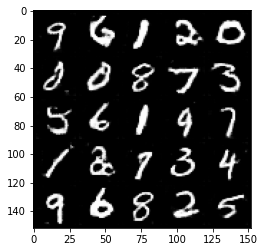

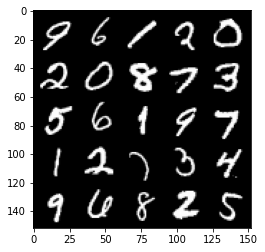

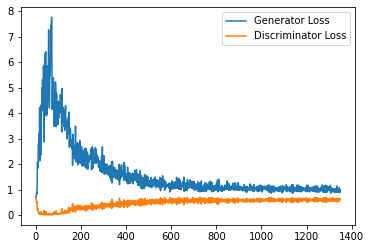

Epoch 58, step 27500: Generator loss: 1.0071724820137025, discriminator loss: 0.6029531829357148


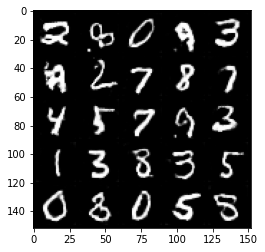

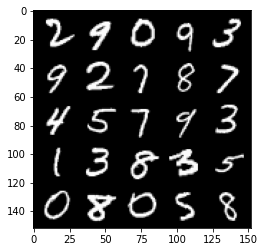

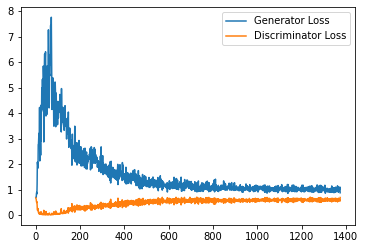

Epoch 59, step 28000: Generator loss: 1.021522722363472, discriminator loss: 0.6030469326972961


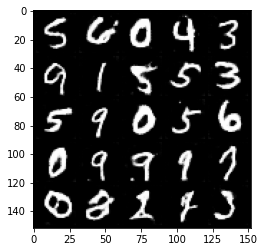

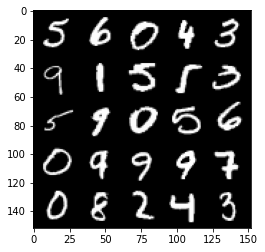

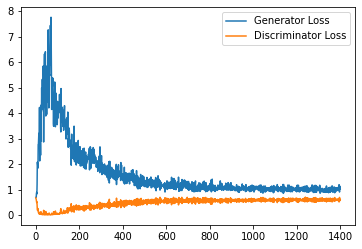

Epoch 60, step 28500: Generator loss: 0.981357585310936, discriminator loss: 0.6060802131295204


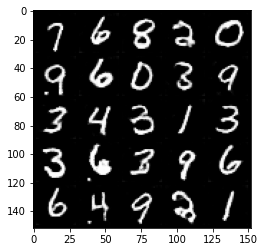

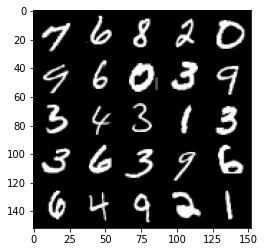

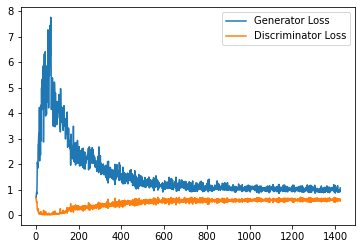

Epoch 61, step 29000: Generator loss: 0.9701515811681748, discriminator loss: 0.6032486075162887


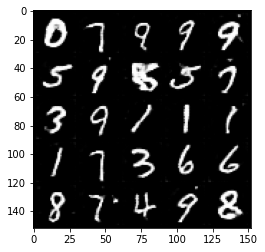

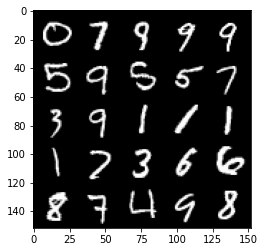

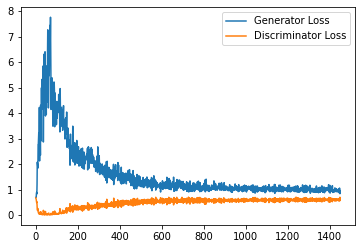

Epoch 62, step 29500: Generator loss: 0.9899750232696534, discriminator loss: 0.6002840803265571


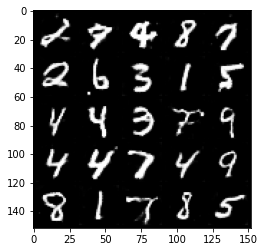

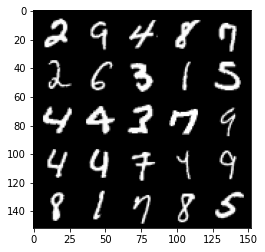

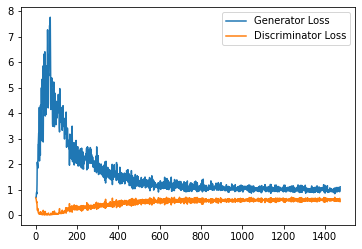

Epoch 63, step 30000: Generator loss: 0.9781133364439011, discriminator loss: 0.6043115108609199


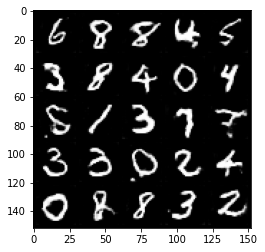

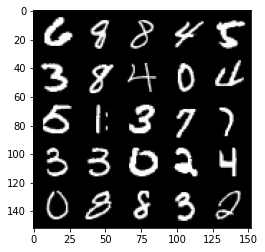

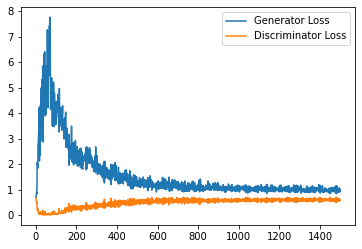

Epoch 65, step 30500: Generator loss: 0.9700550301074982, discriminator loss: 0.6089028636813164


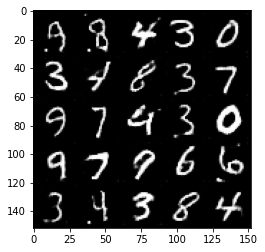

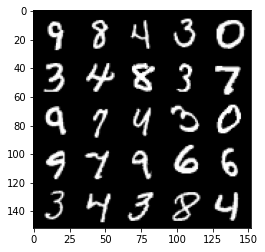

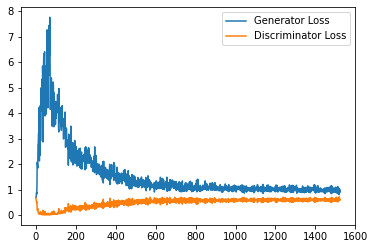

Epoch 66, step 31000: Generator loss: 0.9595675032138824, discriminator loss: 0.6020179712176323


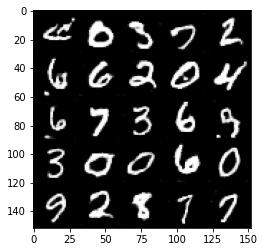

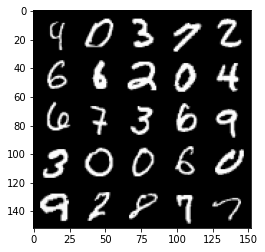

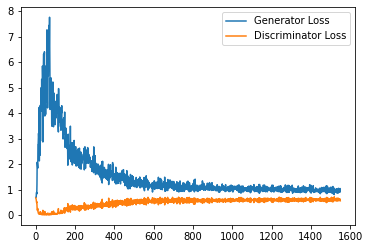

Epoch 67, step 31500: Generator loss: 0.9631364172697068, discriminator loss: 0.60612125903368


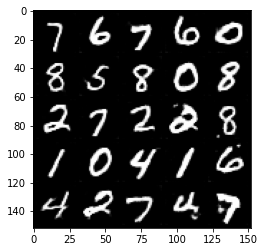

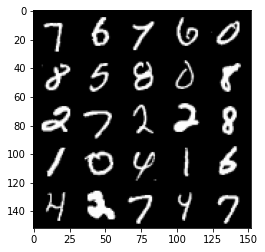

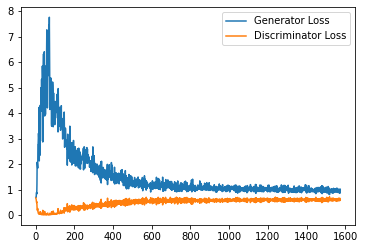

Epoch 68, step 32000: Generator loss: 0.9879455630779266, discriminator loss: 0.6040446872115135


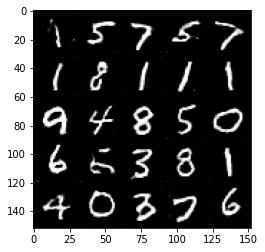

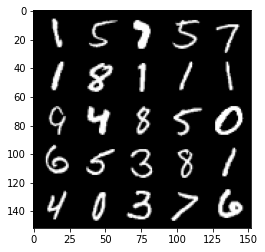

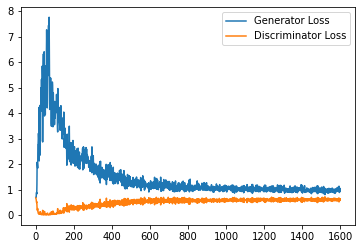

Epoch 69, step 32500: Generator loss: 0.9645732499361038, discriminator loss: 0.6043253903985023


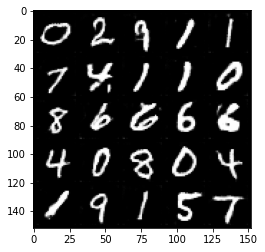

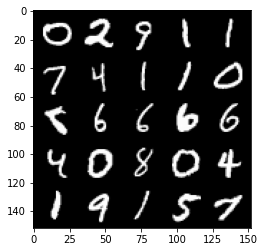

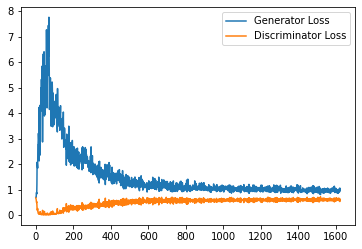

Epoch 70, step 33000: Generator loss: 0.9745089638233185, discriminator loss: 0.6030678879022598


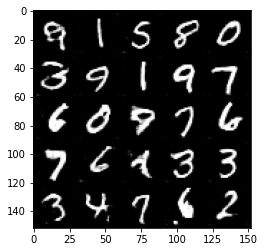

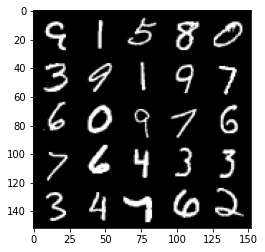

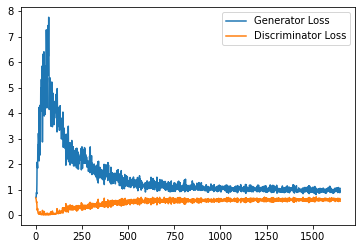

Epoch 71, step 33500: Generator loss: 0.9512569165229797, discriminator loss: 0.6105950657725334


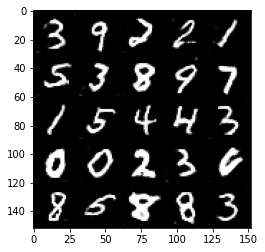

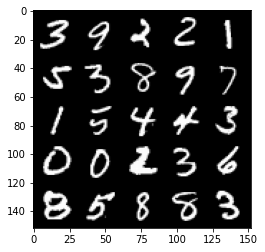

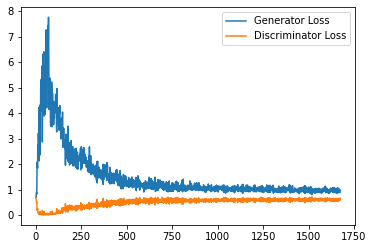

Epoch 72, step 34000: Generator loss: 0.9872774099111556, discriminator loss: 0.6056991391181946


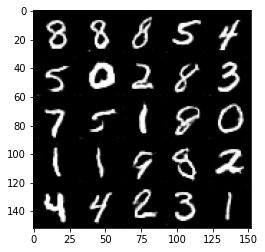

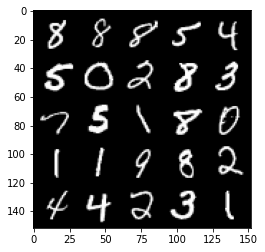

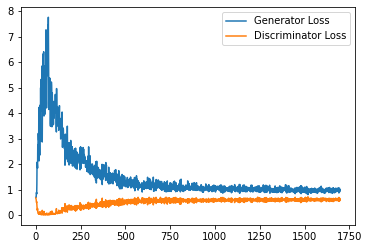

Epoch 73, step 34500: Generator loss: 0.9750128592252731, discriminator loss: 0.6091707122921943


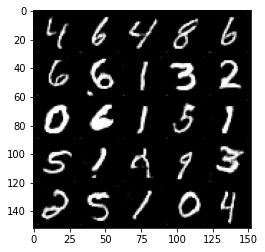

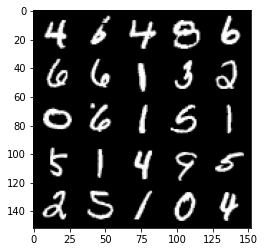

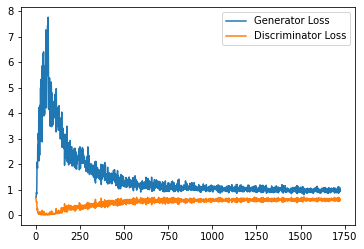

Epoch 74, step 35000: Generator loss: 0.9824344098567963, discriminator loss: 0.6062141827344895


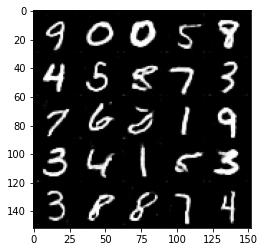

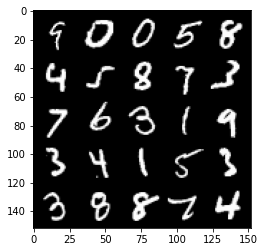

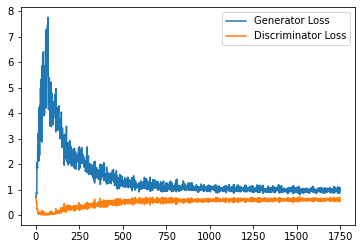

Epoch 75, step 35500: Generator loss: 0.9838479433059693, discriminator loss: 0.6057449789047241


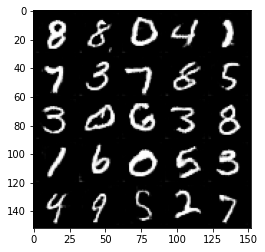

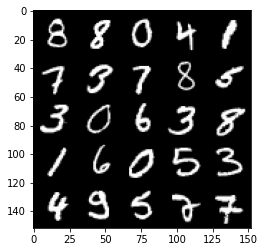

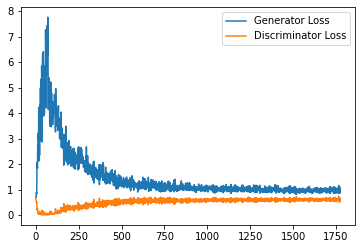

Epoch 76, step 36000: Generator loss: 0.9699951384067536, discriminator loss: 0.6181454144716263


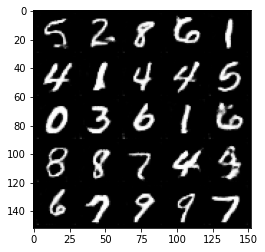

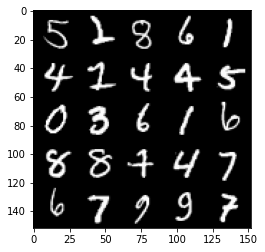

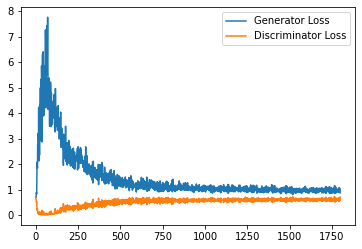

Epoch 77, step 36500: Generator loss: 0.9573992102146148, discriminator loss: 0.6113920538425446


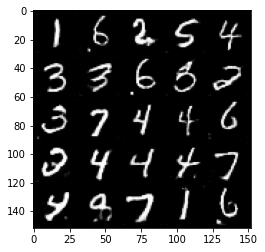

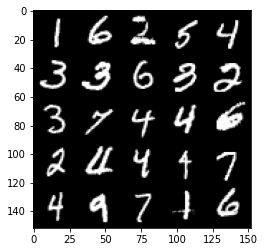

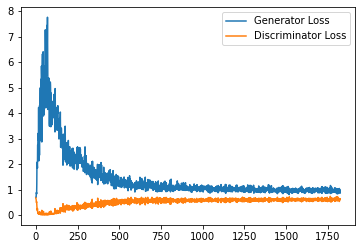

Epoch 78, step 37000: Generator loss: 0.9482159316539764, discriminator loss: 0.60365366345644


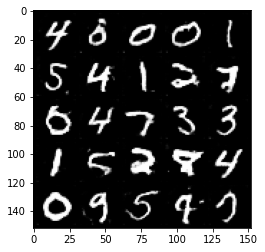

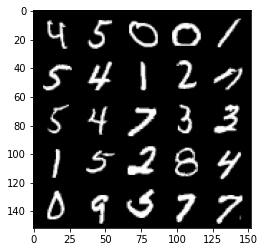

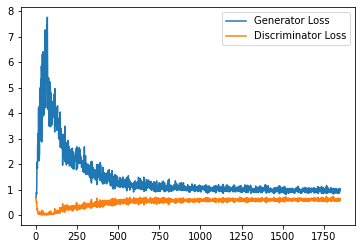

Epoch 79, step 37500: Generator loss: 0.9776838380098343, discriminator loss: 0.6128915168642998


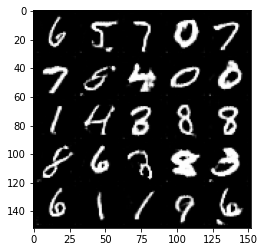

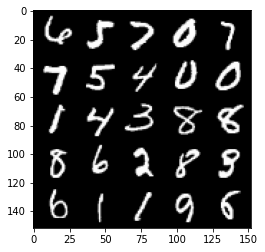

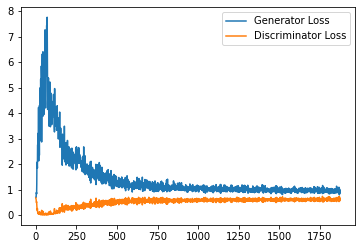

Epoch 81, step 38000: Generator loss: 0.9855362718105316, discriminator loss: 0.6085562563538551


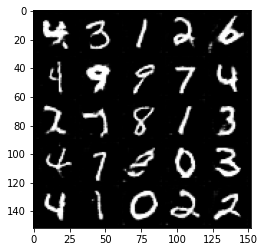

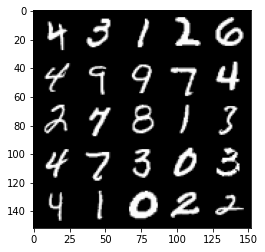

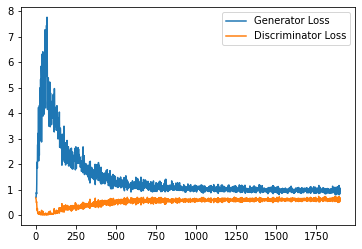

Epoch 82, step 38500: Generator loss: 0.9587113626003265, discriminator loss: 0.6045558881759644


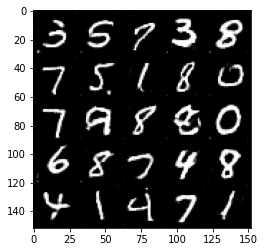

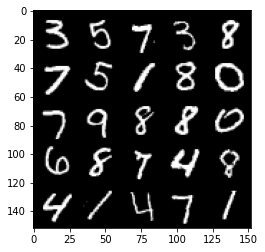

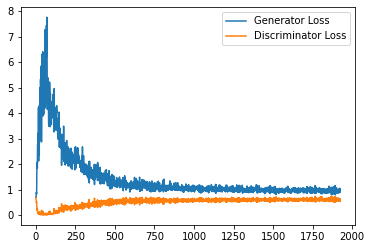

Epoch 83, step 39000: Generator loss: 0.9678655159473419, discriminator loss: 0.6119922649264335


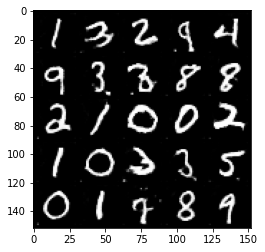

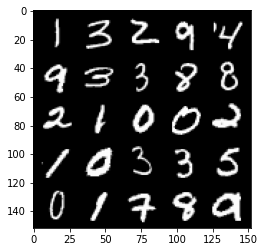

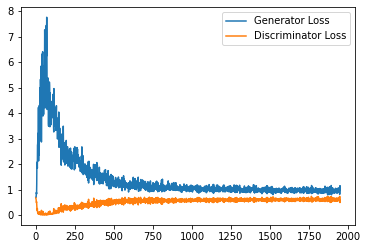

Epoch 84, step 39500: Generator loss: 0.9642946716547013, discriminator loss: 0.6121693796515465


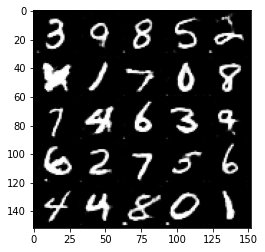

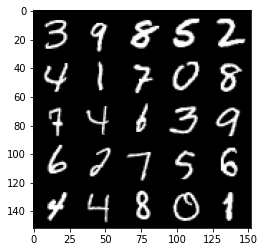

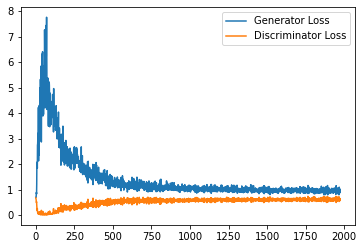

Epoch 85, step 40000: Generator loss: 0.9638802415132522, discriminator loss: 0.610906848013401


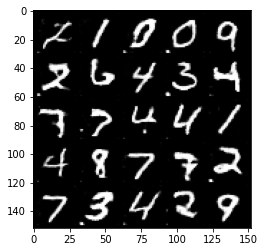

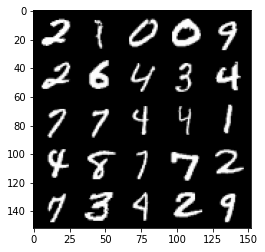

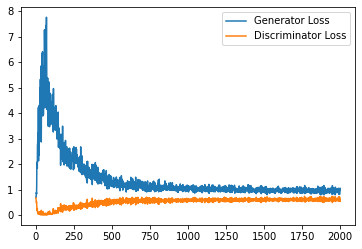

Epoch 86, step 40500: Generator loss: 0.9656915929317474, discriminator loss: 0.6163592458963394


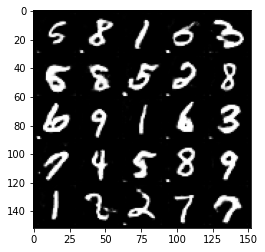

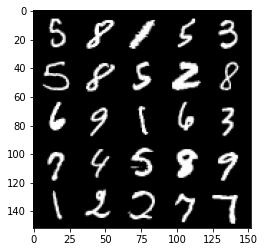

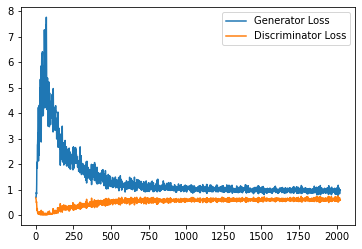

Epoch 87, step 41000: Generator loss: 0.9662433809041977, discriminator loss: 0.6181460950374603


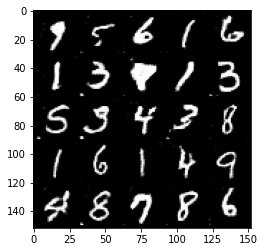

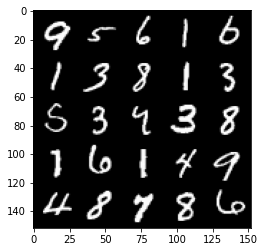

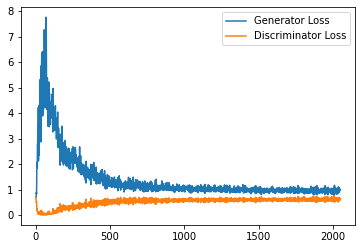

Epoch 88, step 41500: Generator loss: 0.9969149268865586, discriminator loss: 0.6044600407481193


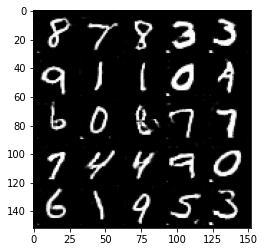

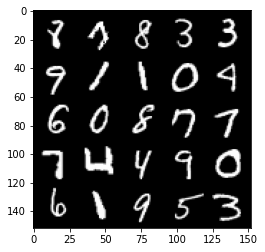

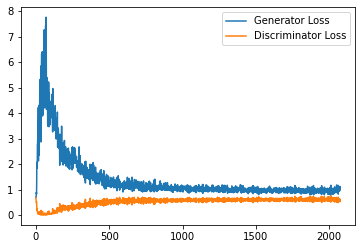

Epoch 89, step 42000: Generator loss: 0.9578465573787689, discriminator loss: 0.6142774934768677


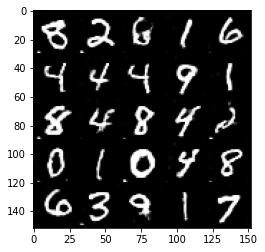

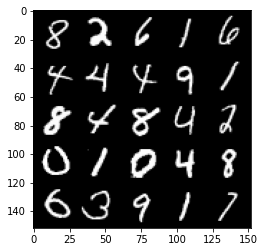

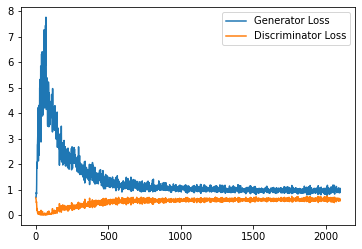

Epoch 90, step 42500: Generator loss: 0.9616941999197006, discriminator loss: 0.6092544415593147


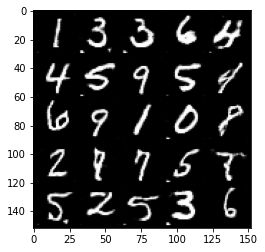

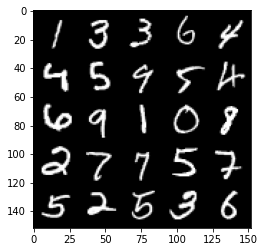

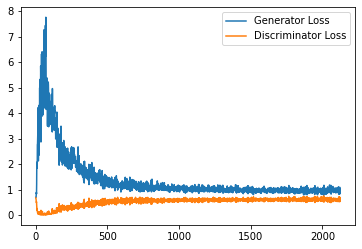

Epoch 91, step 43000: Generator loss: 0.9563007522821426, discriminator loss: 0.6111077279448509


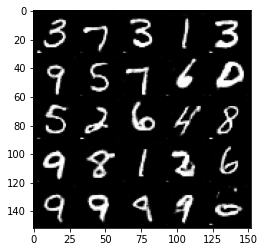

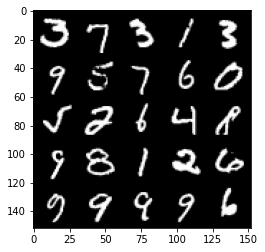

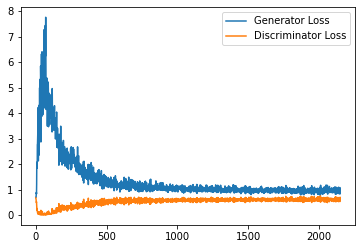

Epoch 92, step 43500: Generator loss: 0.9681822576522827, discriminator loss: 0.6083056035637856


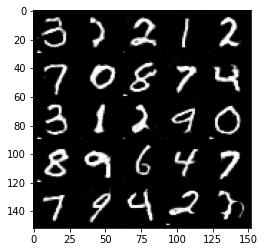

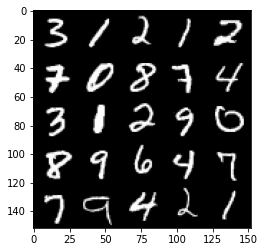

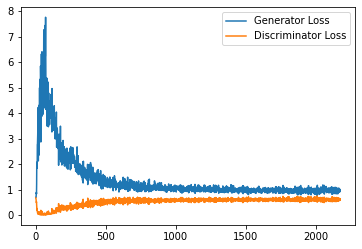

Epoch 93, step 44000: Generator loss: 0.9542040512561798, discriminator loss: 0.6168020202517509


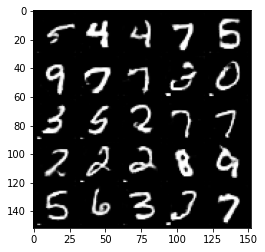

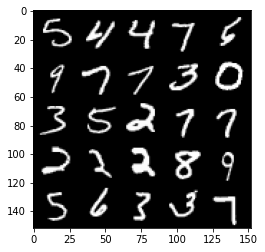

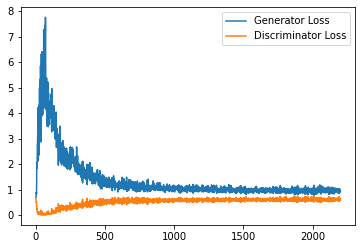

Epoch 94, step 44500: Generator loss: 0.9495203032493591, discriminator loss: 0.6179890349507332


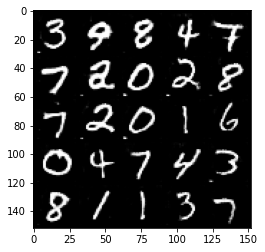

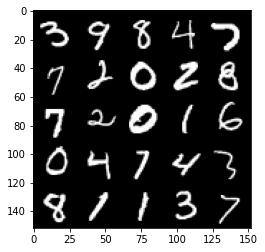

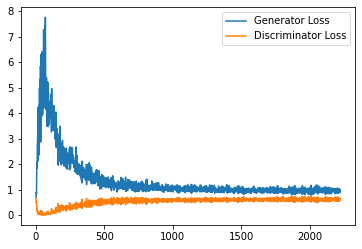

Epoch 95, step 45000: Generator loss: 0.9638490266799927, discriminator loss: 0.6104523181319237


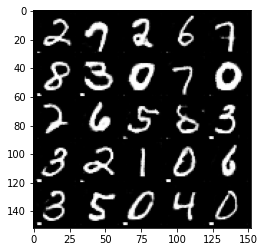

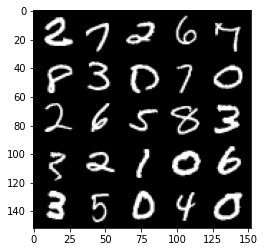

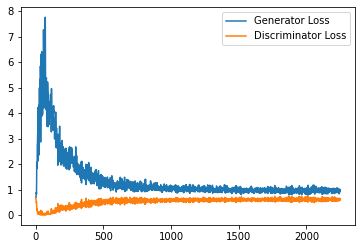

Epoch 97, step 45500: Generator loss: 0.9622951238155365, discriminator loss: 0.6088388352394104


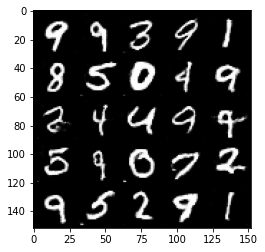

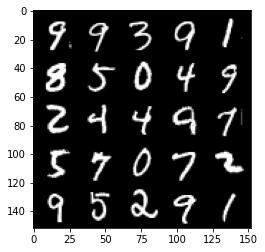

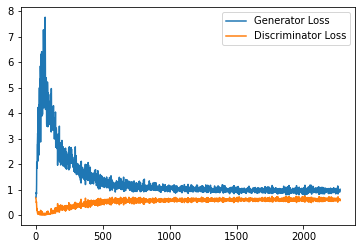

Epoch 98, step 46000: Generator loss: 0.9592451577186585, discriminator loss: 0.6116280862092972


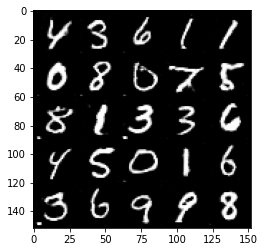

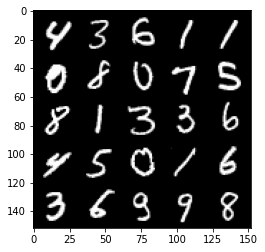

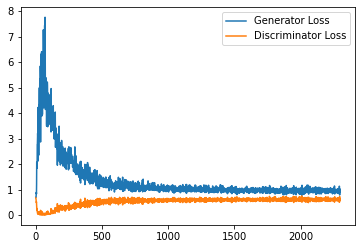

Epoch 99, step 46500: Generator loss: 0.9502298717498779, discriminator loss: 0.6096844397187233


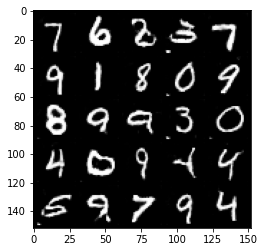

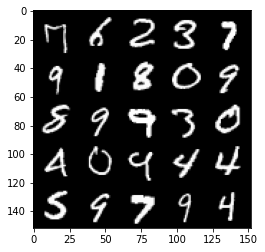

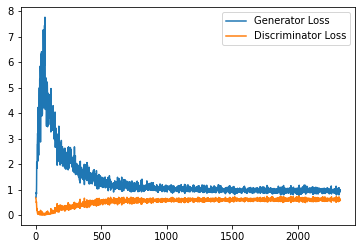

Epoch 100, step 47000: Generator loss: 0.9486286361217499, discriminator loss: 0.6204601382017135


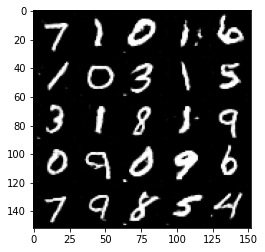

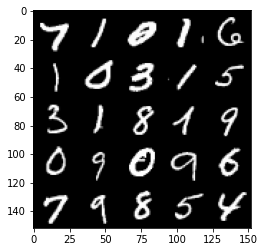

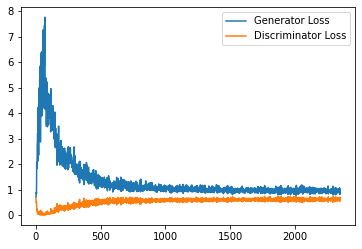

Epoch 101, step 47500: Generator loss: 0.9656735949516296, discriminator loss: 0.6112801599502563


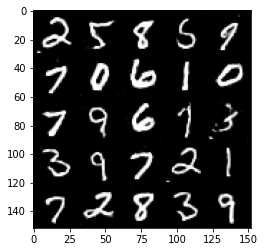

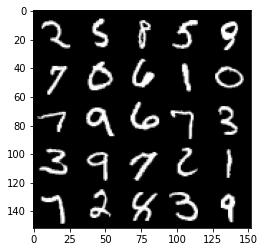

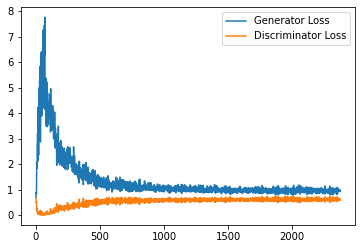

Epoch 102, step 48000: Generator loss: 0.9544368199110032, discriminator loss: 0.611505823969841


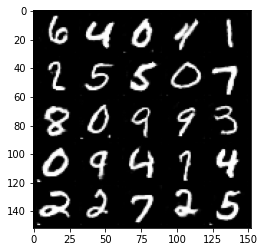

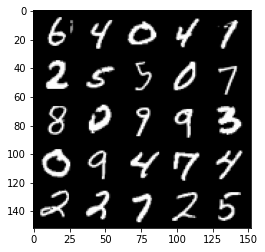

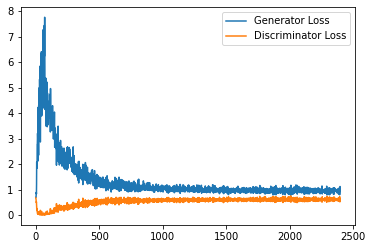

Epoch 103, step 48500: Generator loss: 0.9576568261384965, discriminator loss: 0.6158917218446731


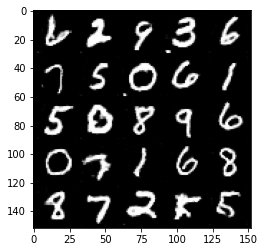

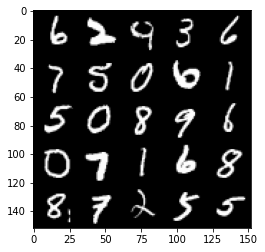

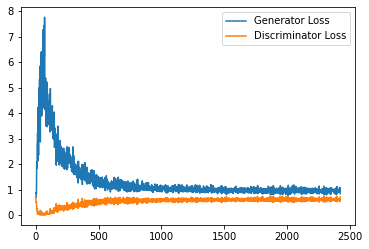

Epoch 104, step 49000: Generator loss: 0.96801839864254, discriminator loss: 0.6108230568766594


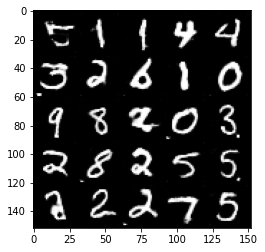

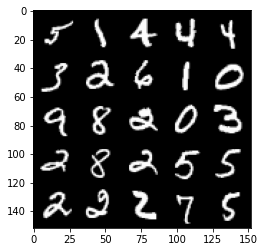

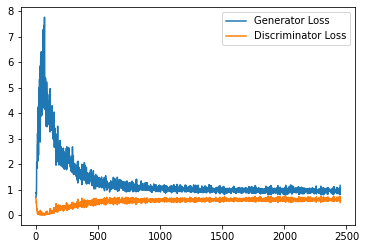

Epoch 105, step 49500: Generator loss: 0.9407212679386139, discriminator loss: 0.6120450588464736


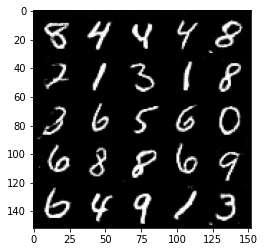

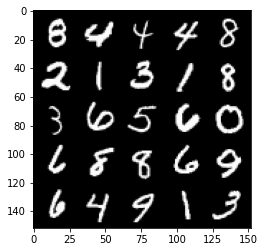

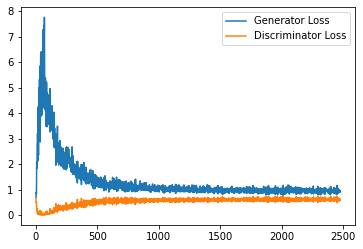

Epoch 106, step 50000: Generator loss: 0.9410680483579635, discriminator loss: 0.6128902235031128


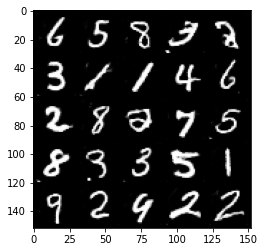

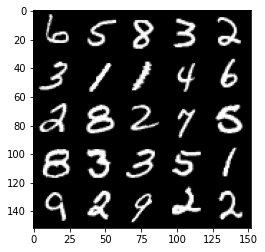

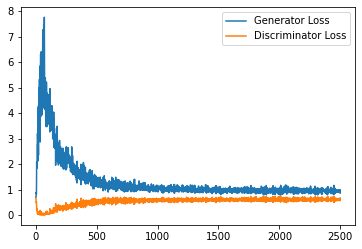

Epoch 107, step 50500: Generator loss: 0.9640790392160415, discriminator loss: 0.6105757169127465


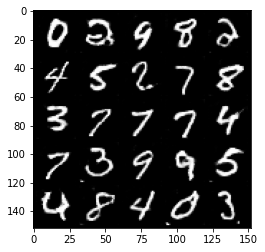

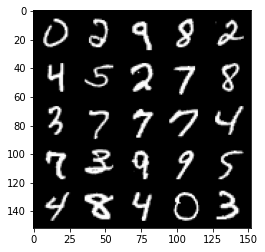

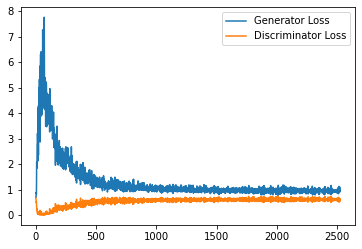

Epoch 108, step 51000: Generator loss: 0.9483163034915925, discriminator loss: 0.614007609307766


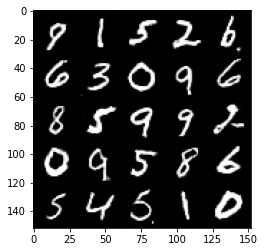

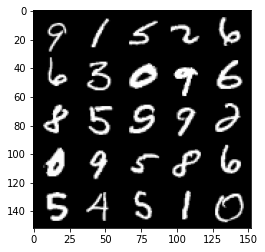

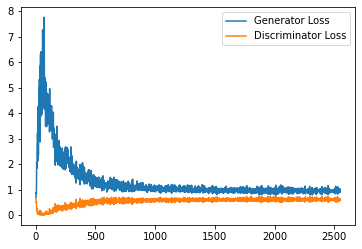

Epoch 109, step 51500: Generator loss: 0.9449331928491592, discriminator loss: 0.6158010677695275


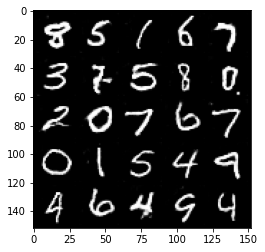

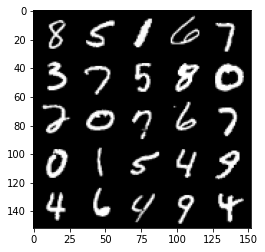

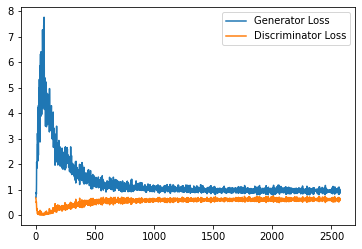

Epoch 110, step 52000: Generator loss: 0.9517889773845672, discriminator loss: 0.6117019301056862


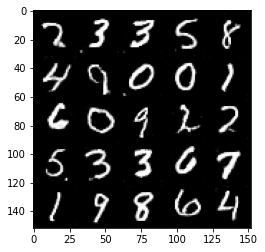

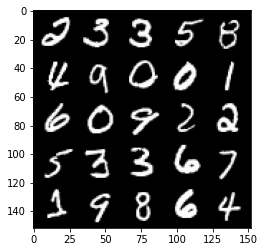

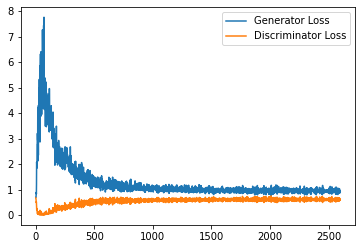

Epoch 111, step 52500: Generator loss: 0.959452333688736, discriminator loss: 0.6127038820385933


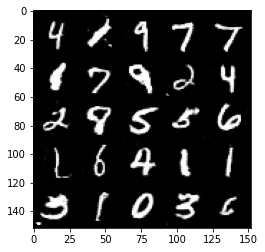

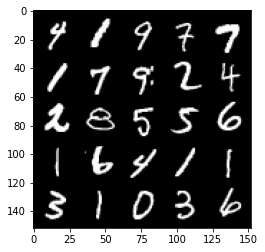

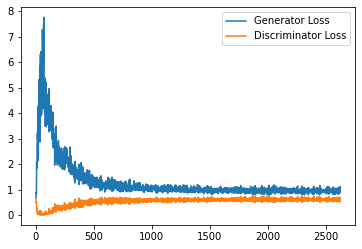

Epoch 113, step 53000: Generator loss: 0.9617255966663361, discriminator loss: 0.6156497014164924


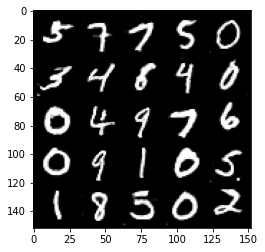

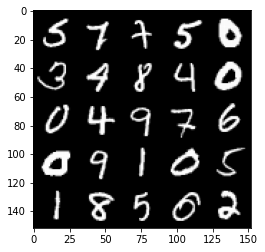

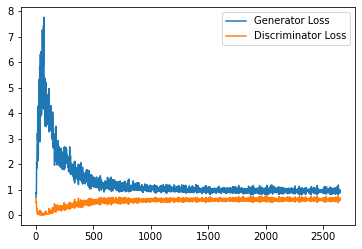

Epoch 114, step 53500: Generator loss: 0.9470647068023682, discriminator loss: 0.6128798179626465


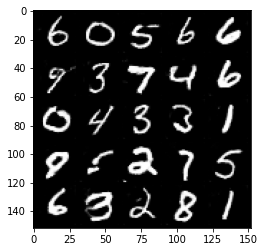

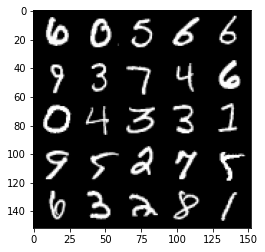

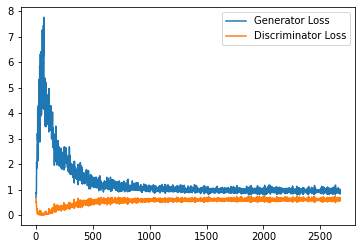

Epoch 115, step 54000: Generator loss: 0.9511074563264846, discriminator loss: 0.6079367017745971


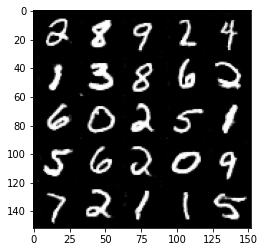

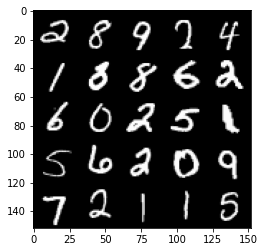

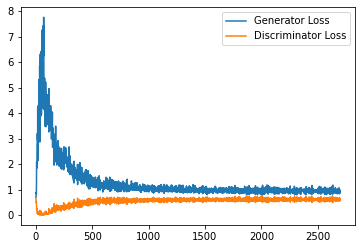

Epoch 116, step 54500: Generator loss: 0.9479187101125717, discriminator loss: 0.6053450194001198


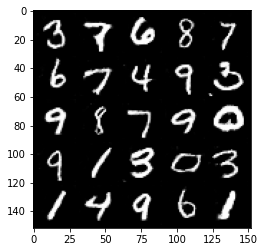

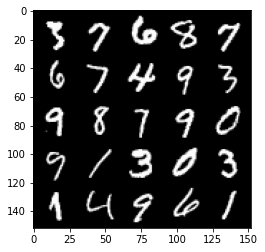

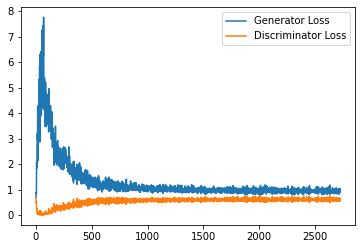

Epoch 117, step 55000: Generator loss: 0.9732659214735031, discriminator loss: 0.6134122300744057


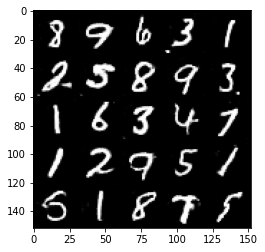

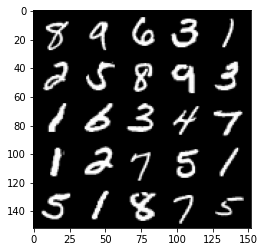

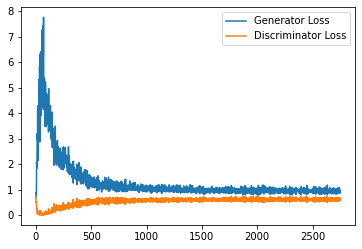

Epoch 118, step 55500: Generator loss: 0.9513132169246673, discriminator loss: 0.6121667625904084


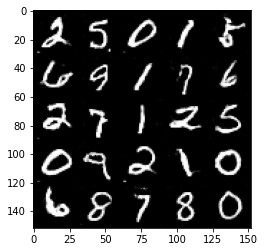

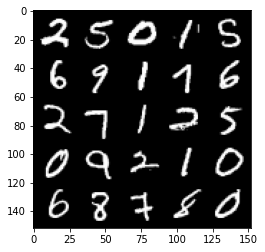

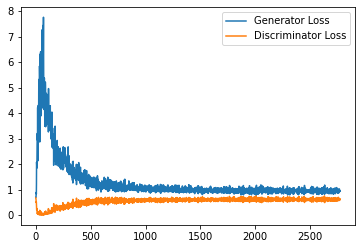

Epoch 119, step 56000: Generator loss: 0.9429399448633194, discriminator loss: 0.6095657725334167


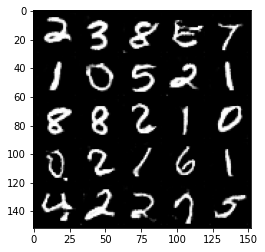

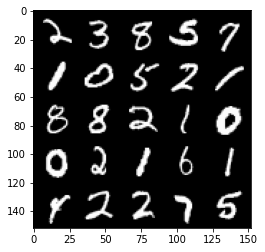

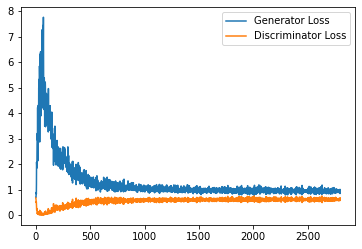

Epoch 120, step 56500: Generator loss: 0.9615583225488663, discriminator loss: 0.6038355504870415


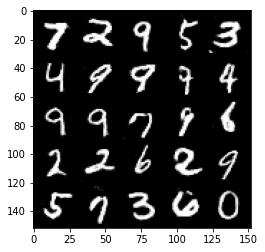

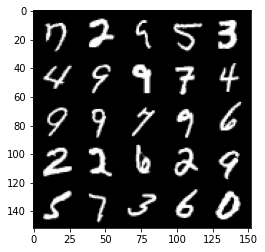

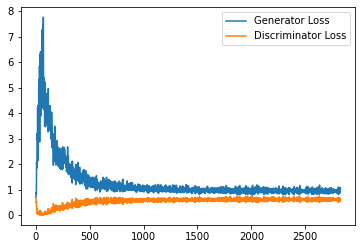

Epoch 121, step 57000: Generator loss: 0.9787264575958252, discriminator loss: 0.6056326498389244


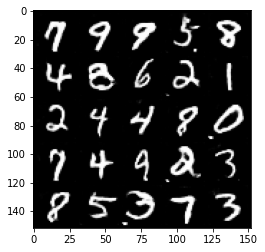

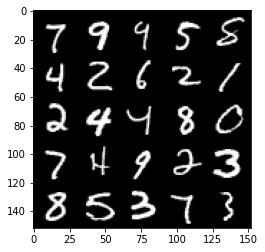

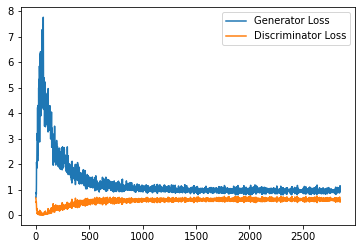

Epoch 122, step 57500: Generator loss: 0.9514101709127426, discriminator loss: 0.6129859246611595


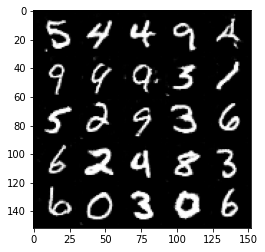

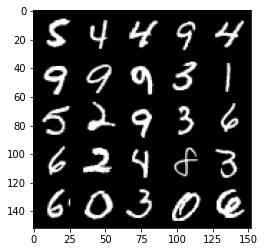

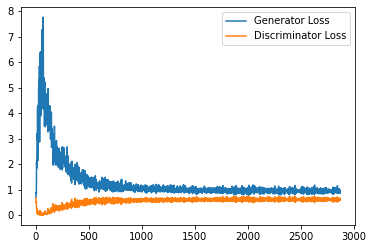

Epoch 123, step 58000: Generator loss: 0.9744825083017349, discriminator loss: 0.6051396919488907


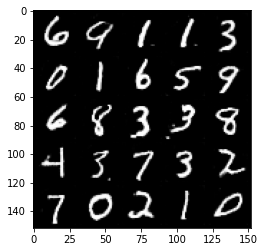

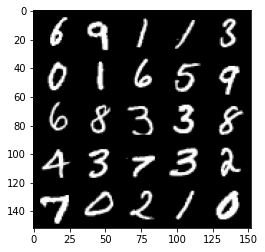

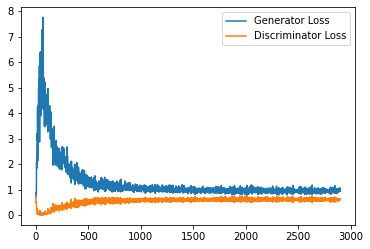

Epoch 124, step 58500: Generator loss: 0.9452252144813538, discriminator loss: 0.6116302464604377


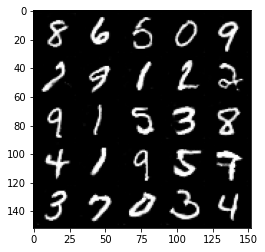

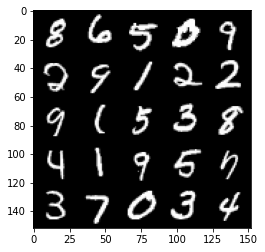

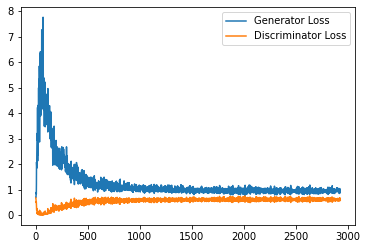

Epoch 125, step 59000: Generator loss: 0.9557705870866775, discriminator loss: 0.6031065356135369


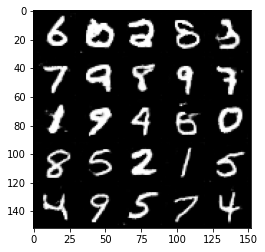

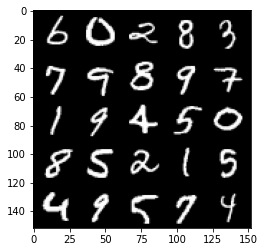

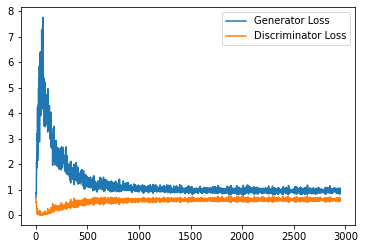

Epoch 126, step 59500: Generator loss: 0.9659572497606278, discriminator loss: 0.6145919979214668


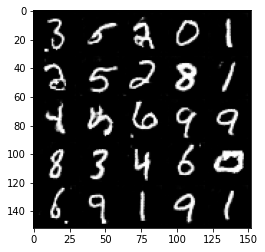

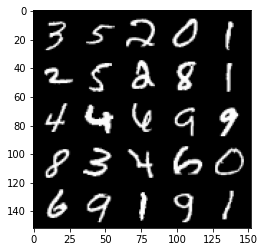

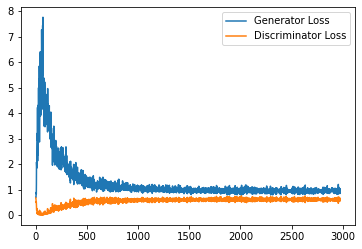

Epoch 127, step 60000: Generator loss: 0.9761110534667968, discriminator loss: 0.6014645830988884


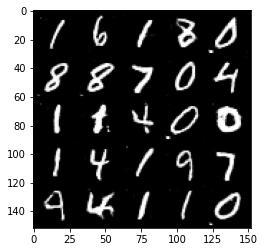

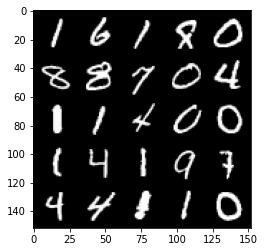

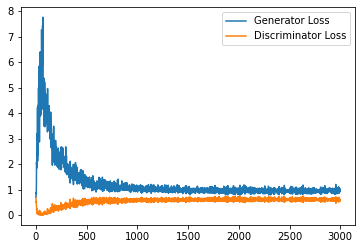

Epoch 128, step 60500: Generator loss: 0.9397056496143341, discriminator loss: 0.612938775062561


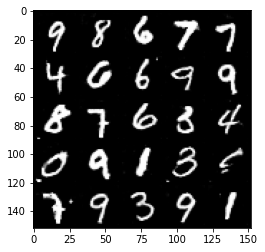

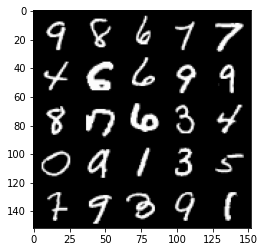

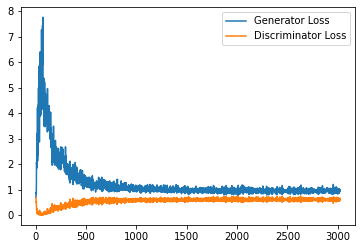

Epoch 130, step 61000: Generator loss: 0.9537555865049362, discriminator loss: 0.6068277738690376


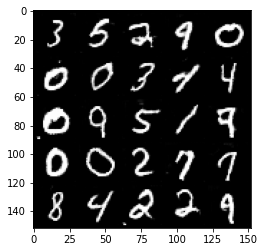

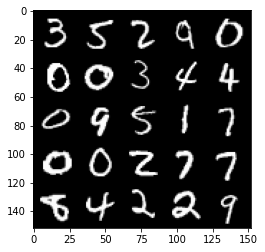

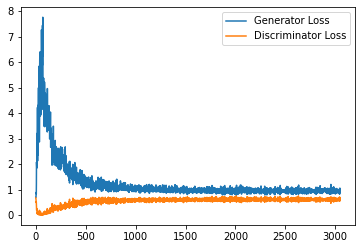

Epoch 131, step 61500: Generator loss: 0.97874613904953, discriminator loss: 0.6010656796097755


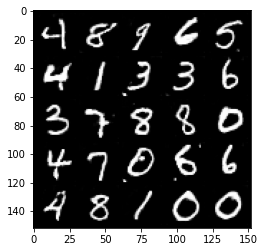

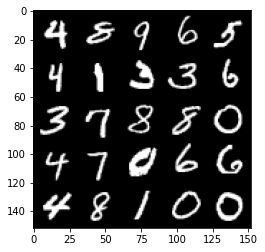

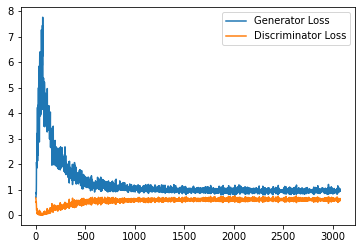

Epoch 132, step 62000: Generator loss: 0.9838521578311921, discriminator loss: 0.5954776839017868


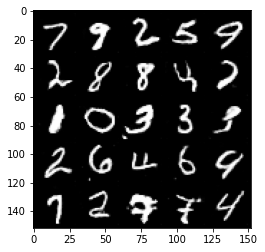

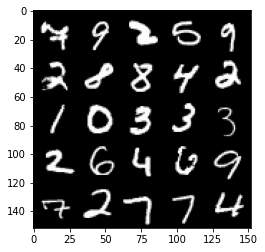

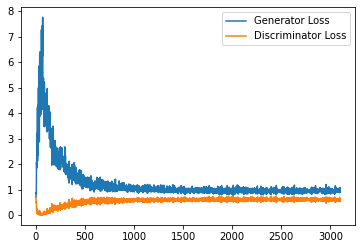

Epoch 133, step 62500: Generator loss: 0.951591056227684, discriminator loss: 0.605332524895668


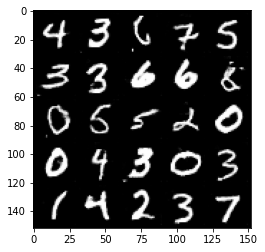

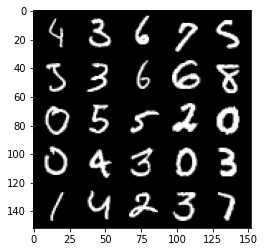

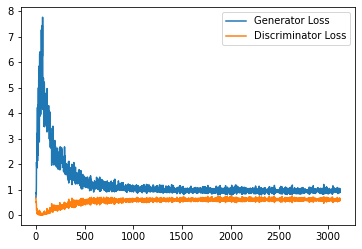

Epoch 134, step 63000: Generator loss: 0.9614952105283737, discriminator loss: 0.6044193773865699


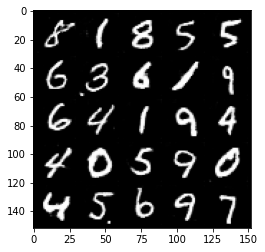

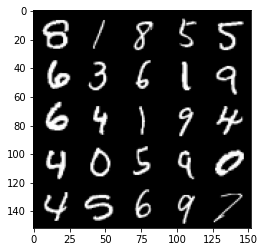

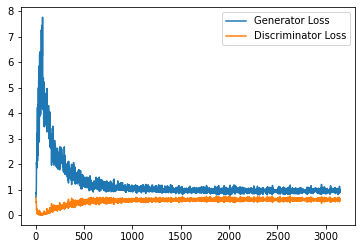

Epoch 135, step 63500: Generator loss: 0.9652047456502915, discriminator loss: 0.6024224932193756


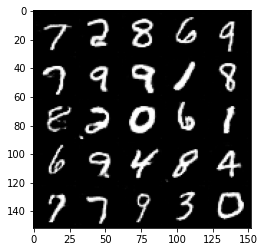

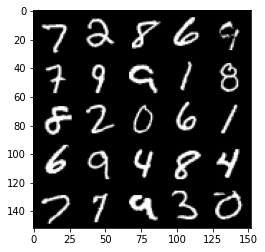

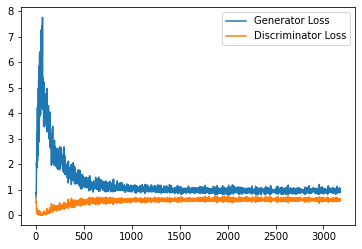

Epoch 136, step 64000: Generator loss: 0.9775920182466507, discriminator loss: 0.6020336024165154


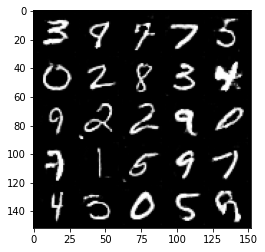

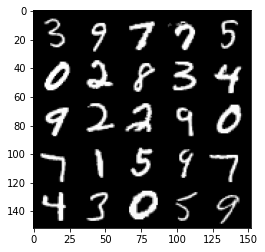

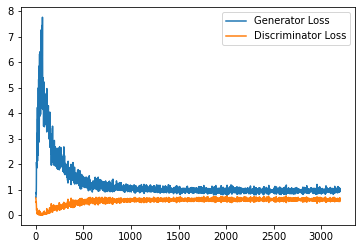

Epoch 137, step 64500: Generator loss: 0.9575756086111069, discriminator loss: 0.6054249172210693


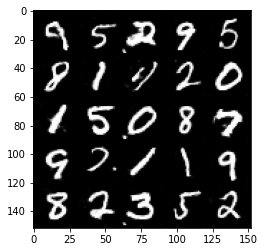

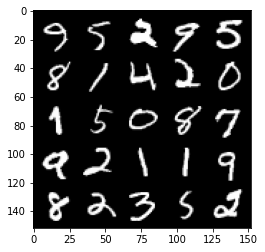

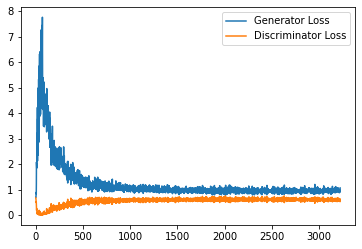

Epoch 138, step 65000: Generator loss: 0.9586706023216247, discriminator loss: 0.6024538152217865


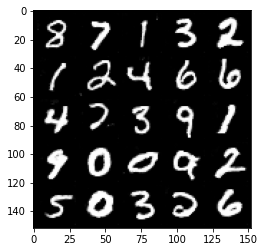

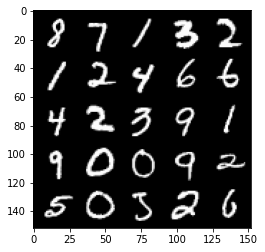

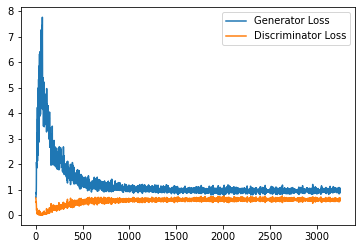

Epoch 139, step 65500: Generator loss: 0.9628304263353348, discriminator loss: 0.6049523504972458


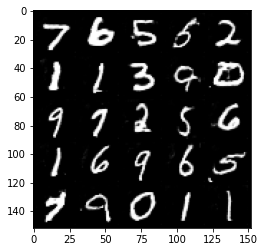

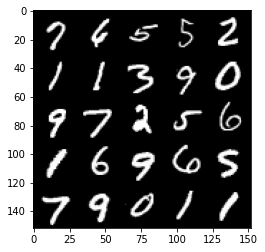

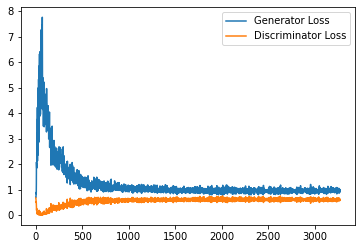

Epoch 140, step 66000: Generator loss: 0.9691324353218078, discriminator loss: 0.602432492673397


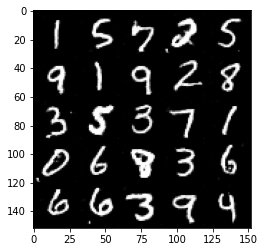

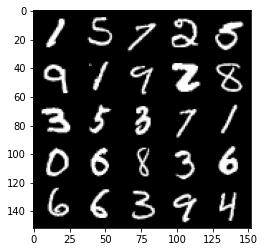

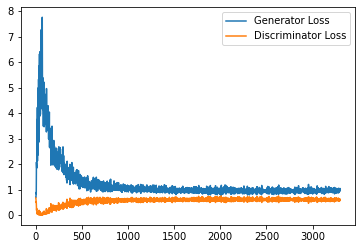

Epoch 141, step 66500: Generator loss: 0.9703861430883408, discriminator loss: 0.6011200979948044


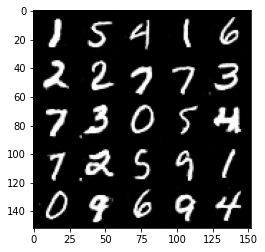

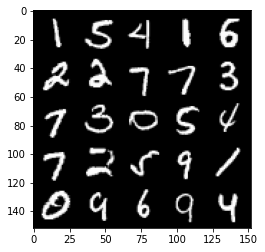

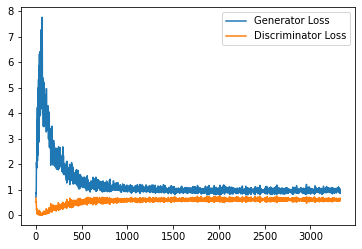

Epoch 142, step 67000: Generator loss: 0.9647586300373078, discriminator loss: 0.599283108830452


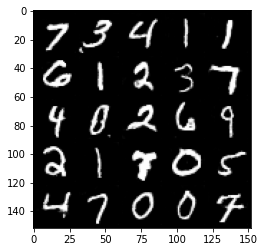

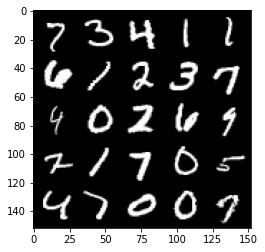

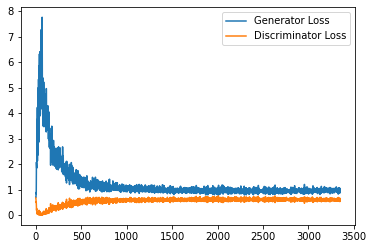

Epoch 143, step 67500: Generator loss: 0.9738749912977218, discriminator loss: 0.6033526321053505


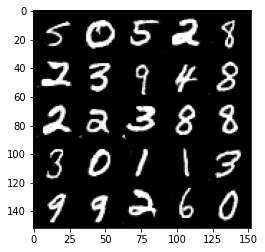

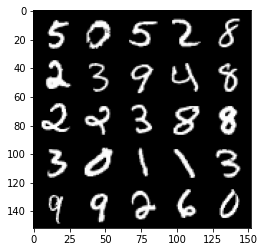

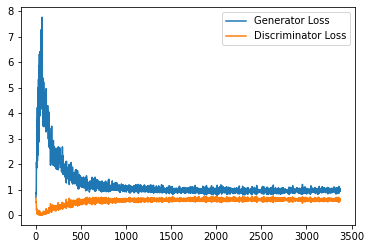

Epoch 144, step 68000: Generator loss: 0.9726144465208053, discriminator loss: 0.5978505104780197


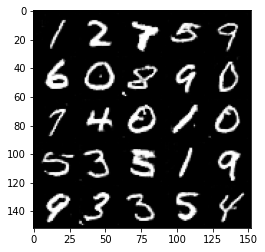

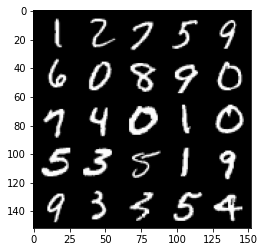

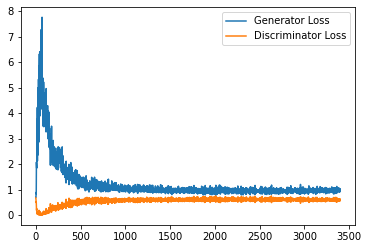

Epoch 146, step 68500: Generator loss: 0.973211421251297, discriminator loss: 0.6020399351716041


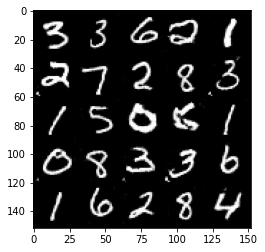

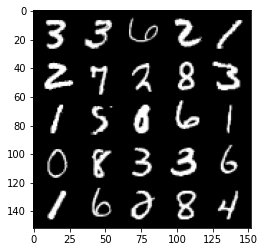

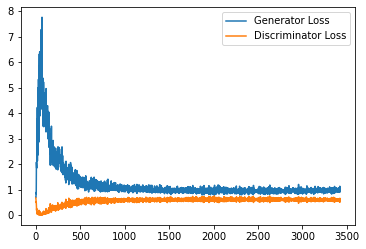

Epoch 147, step 69000: Generator loss: 0.9814520367383957, discriminator loss: 0.5968276529312134


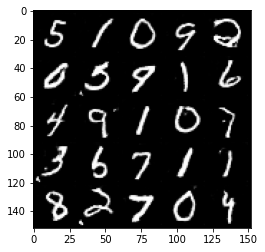

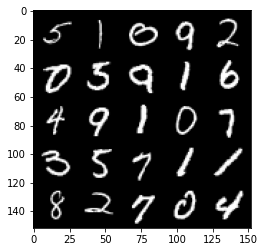

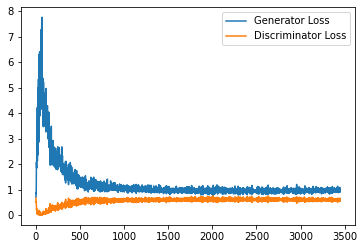

Epoch 148, step 69500: Generator loss: 0.9750093959569931, discriminator loss: 0.5997932902574539


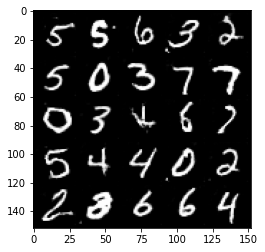

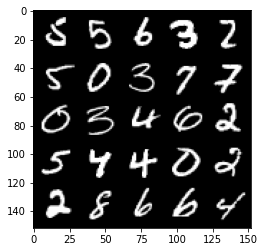

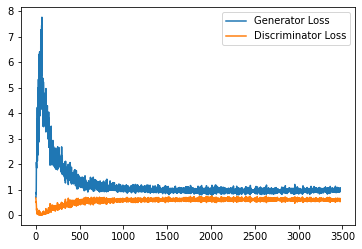

Epoch 149, step 70000: Generator loss: 0.9579228042364121, discriminator loss: 0.5985463650226593


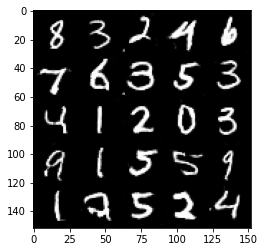

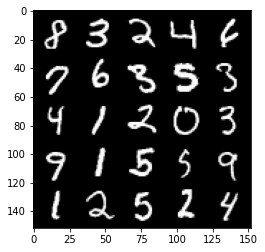

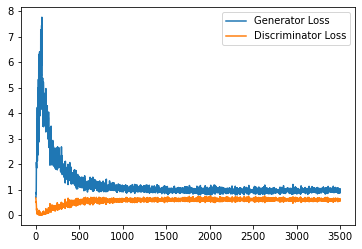

Epoch 150, step 70500: Generator loss: 0.9817254359722137, discriminator loss: 0.5996883814334869


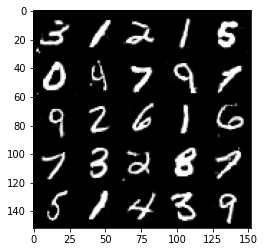

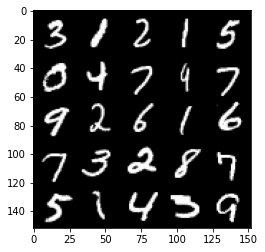

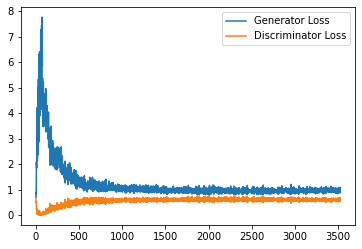

Epoch 151, step 71000: Generator loss: 1.0037954053878784, discriminator loss: 0.5944508276581765


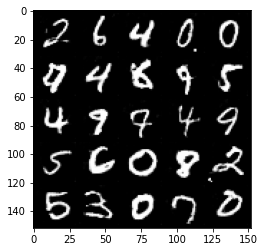

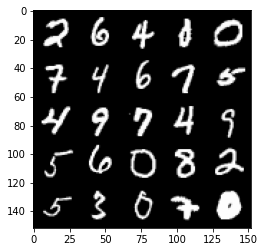

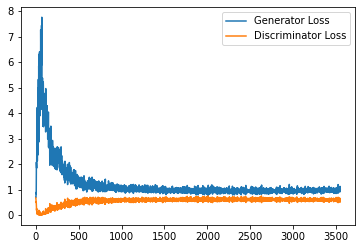

Epoch 152, step 71500: Generator loss: 0.9822905303239823, discriminator loss: 0.6028538016080857


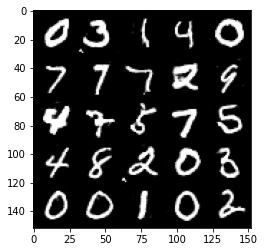

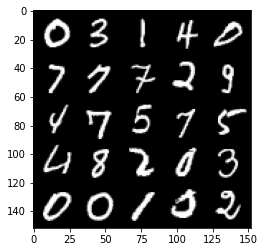

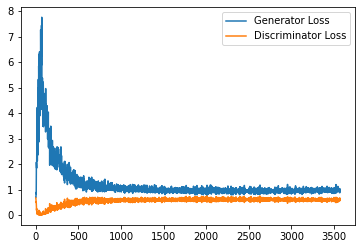

Epoch 153, step 72000: Generator loss: 0.9699409108161926, discriminator loss: 0.6020408999323845


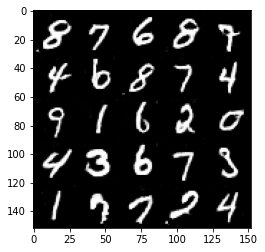

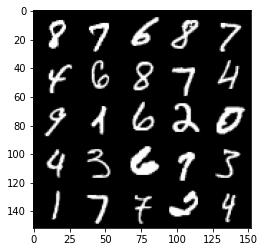

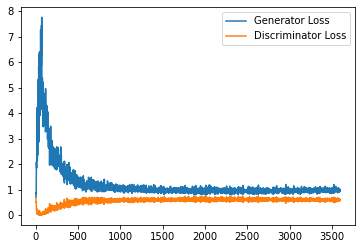

Epoch 154, step 72500: Generator loss: 0.9879265474081039, discriminator loss: 0.5974499742388726


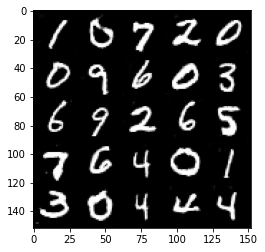

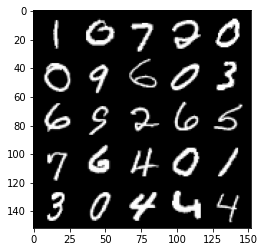

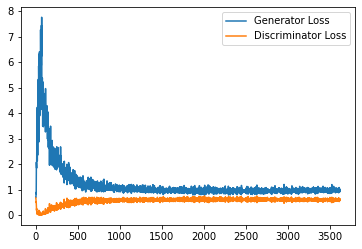

Epoch 155, step 73000: Generator loss: 1.0030478831529617, discriminator loss: 0.5968126465678215


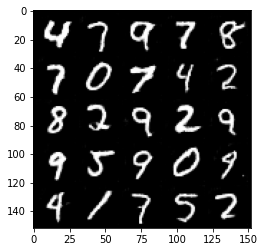

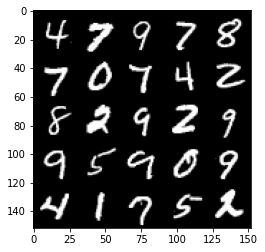

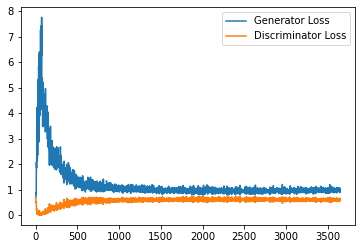

Epoch 156, step 73500: Generator loss: 1.0008969284296036, discriminator loss: 0.5945247569680214


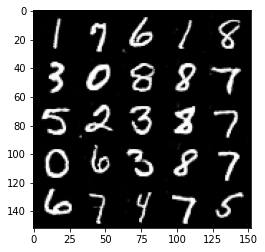

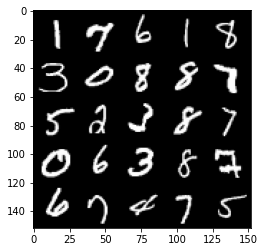

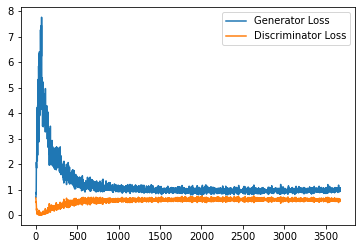

Epoch 157, step 74000: Generator loss: 0.9760695210695267, discriminator loss: 0.596985889017582


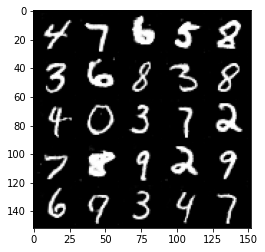

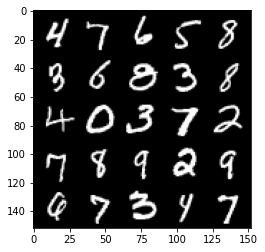

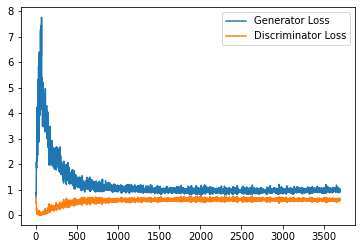

Epoch 158, step 74500: Generator loss: 0.9863012856245041, discriminator loss: 0.5946052088141441


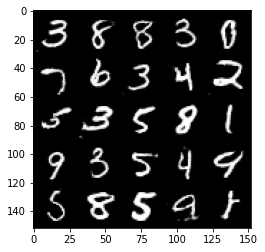

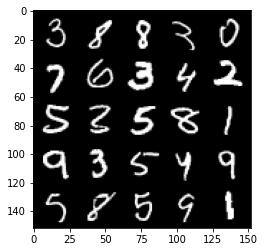

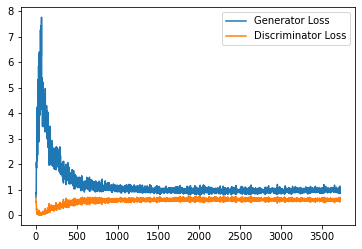

Epoch 159, step 75000: Generator loss: 0.9718654321432114, discriminator loss: 0.6040446218848229


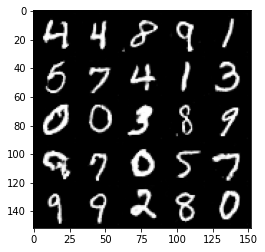

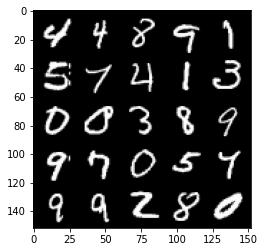

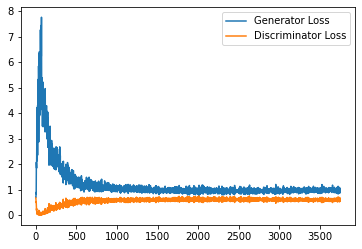

Epoch 160, step 75500: Generator loss: 0.9772892636060715, discriminator loss: 0.5973735308647156


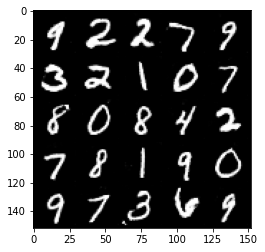

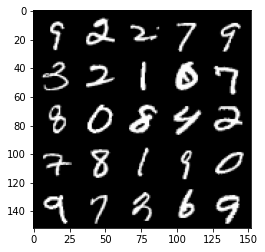

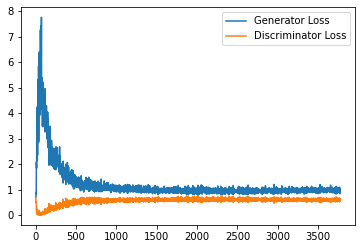

Epoch 162, step 76000: Generator loss: 0.9971970499753952, discriminator loss: 0.5957174806594848


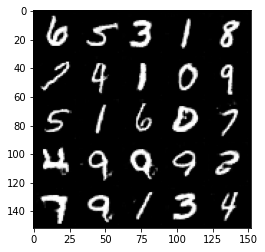

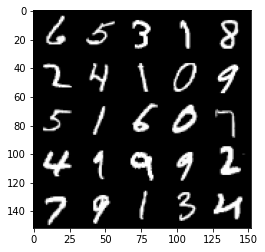

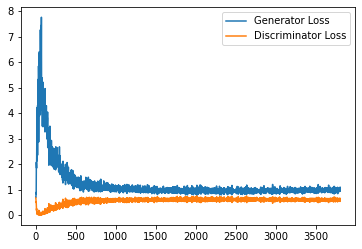

Epoch 163, step 76500: Generator loss: 0.9869931746721268, discriminator loss: 0.5968017391562462


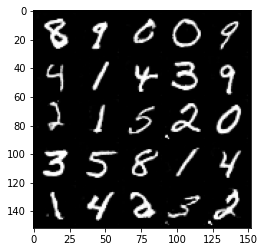

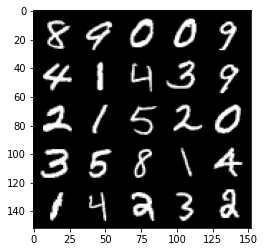

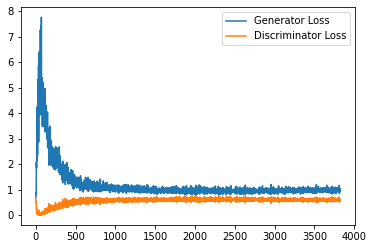

Epoch 164, step 77000: Generator loss: 0.9762194539308549, discriminator loss: 0.6003376504778862


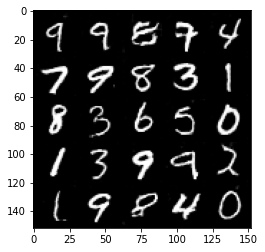

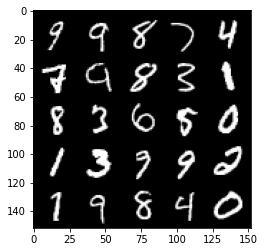

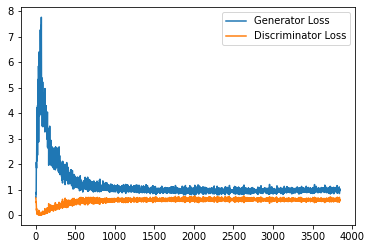

Epoch 165, step 77500: Generator loss: 0.9725159684419632, discriminator loss: 0.5940037630796432


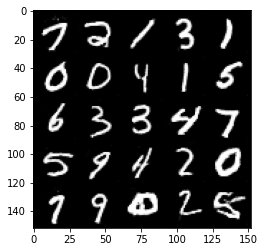

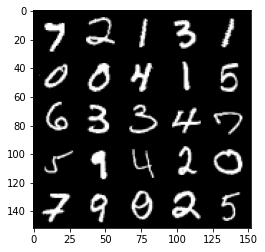

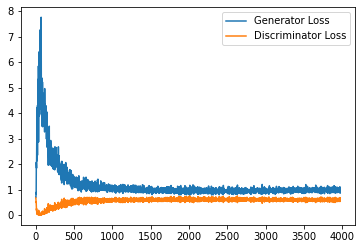

Epoch 170, step 80000: Generator loss: 0.9984689570665359, discriminator loss: 0.592581684589386


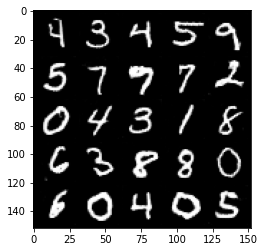

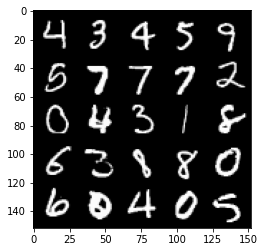

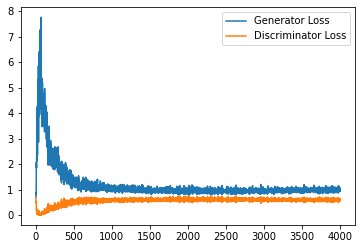

Epoch 171, step 80500: Generator loss: 0.9957854375839233, discriminator loss: 0.592315476000309


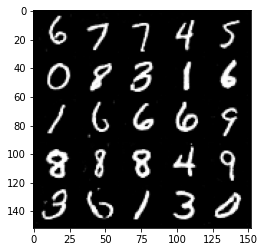

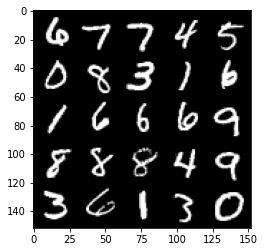

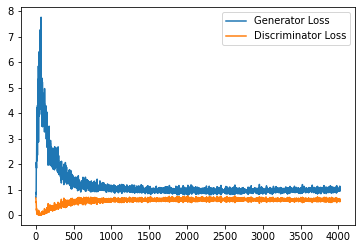

Epoch 172, step 81000: Generator loss: 0.9850228908061981, discriminator loss: 0.5956720574498177


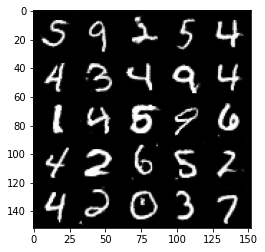

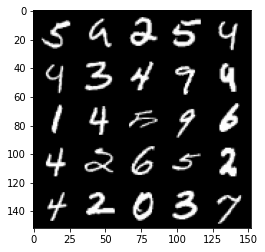

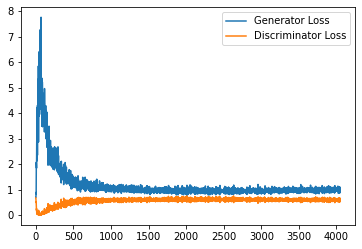

Epoch 173, step 81500: Generator loss: 0.9815773830413819, discriminator loss: 0.5919464974999428


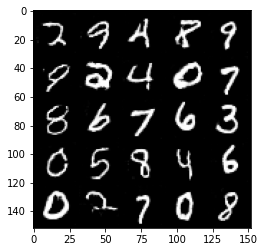

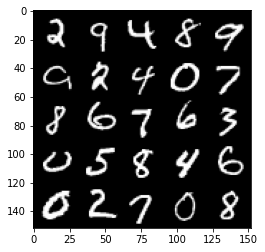

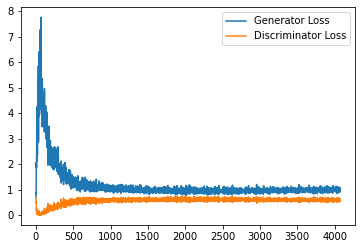

Epoch 174, step 82000: Generator loss: 0.9807403676509857, discriminator loss: 0.5961196683645248


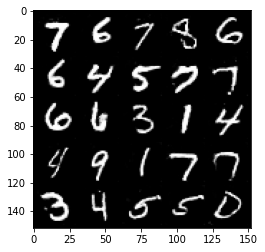

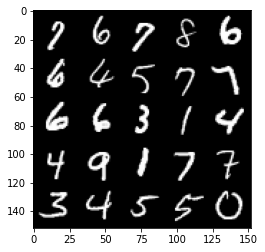

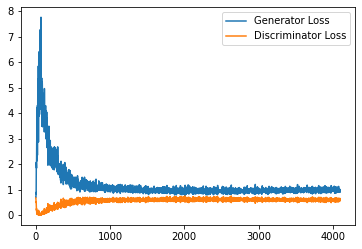

Epoch 175, step 82500: Generator loss: 0.9874688183069229, discriminator loss: 0.5922191817760467


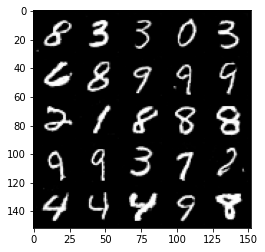

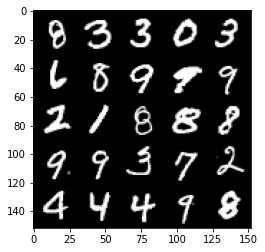

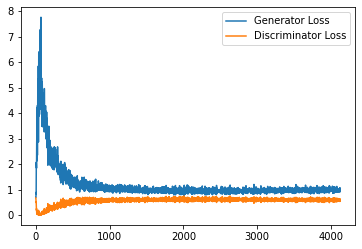

Epoch 176, step 83000: Generator loss: 0.9729666067361832, discriminator loss: 0.597671053469181


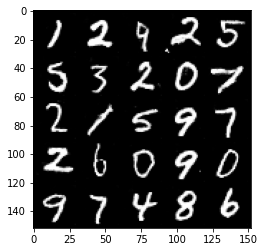

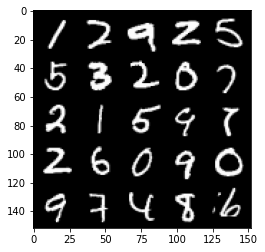

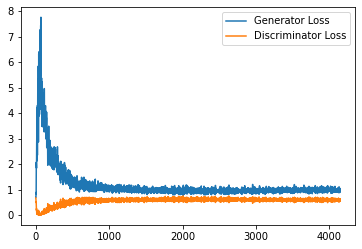

Epoch 178, step 83500: Generator loss: 1.0126357177495957, discriminator loss: 0.5889581358432769


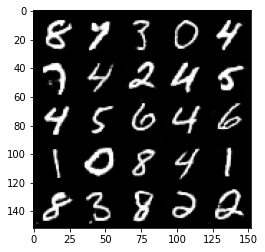

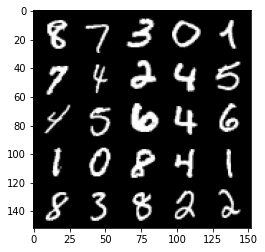

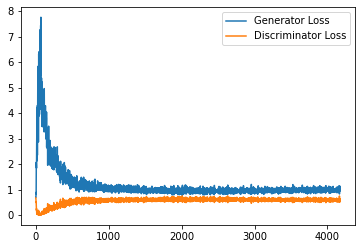

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 189, step 89000: Generator loss: 0.9941637151241303, discriminator loss: 0.5879571022391319


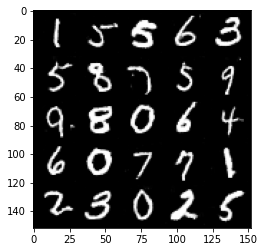

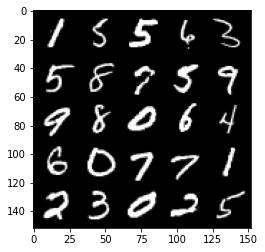

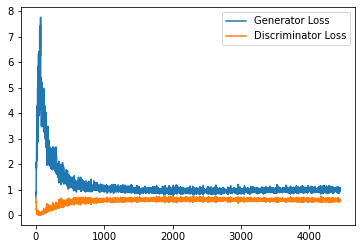

Epoch 190, step 89500: Generator loss: 1.0097132133245468, discriminator loss: 0.5949491688609123


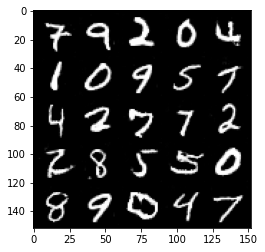

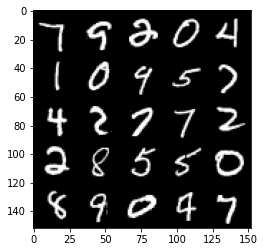

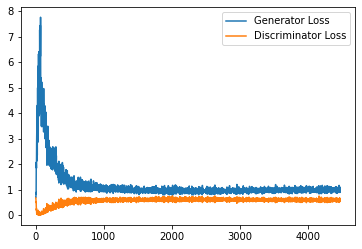

Epoch 191, step 90000: Generator loss: 1.0115828346014022, discriminator loss: 0.5937834405899047


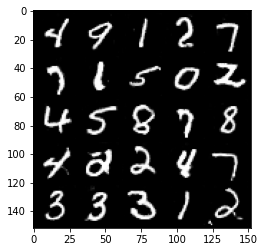

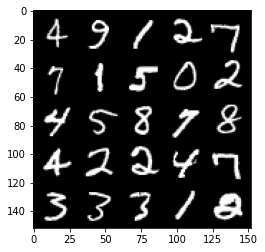

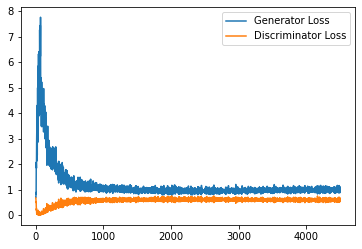

Epoch 192, step 90500: Generator loss: 1.0074344005584717, discriminator loss: 0.5840345672369003


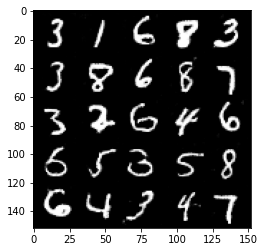

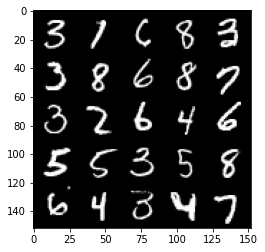

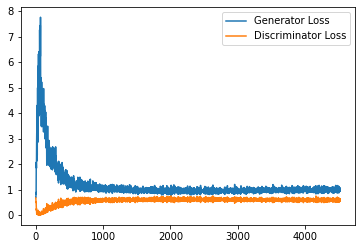

Epoch 194, step 91000: Generator loss: 1.0031862882375717, discriminator loss: 0.5906823295950889


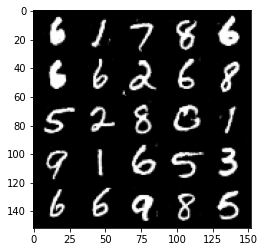

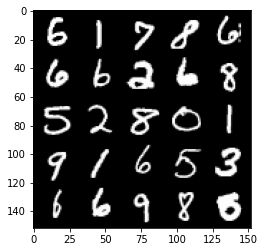

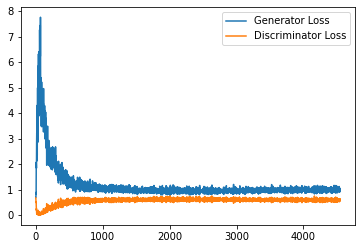

Epoch 195, step 91500: Generator loss: 1.0023788415193557, discriminator loss: 0.5915515342950821


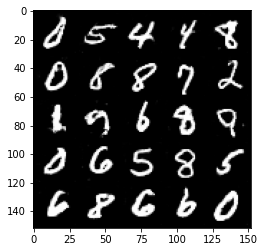

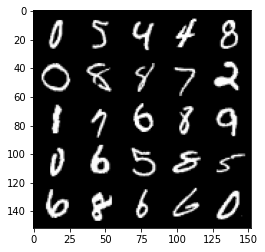

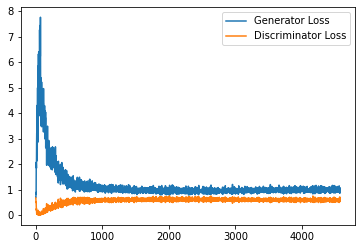

Epoch 196, step 92000: Generator loss: 1.0239697905778884, discriminator loss: 0.5903406125307084


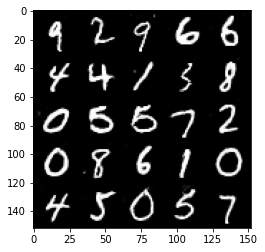

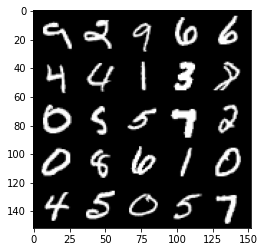

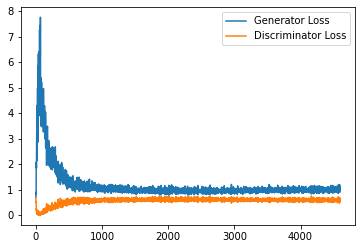

Epoch 197, step 92500: Generator loss: 1.0147429571151734, discriminator loss: 0.5900634002685546


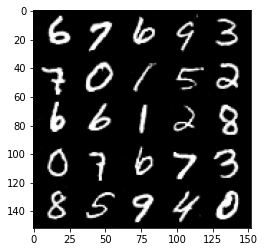

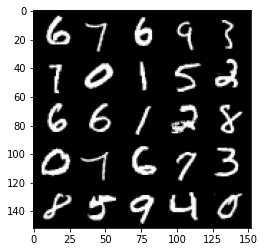

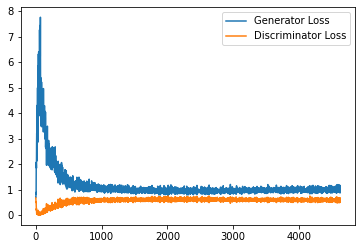

Epoch 198, step 93000: Generator loss: 0.9922495244741439, discriminator loss: 0.5894658929109573


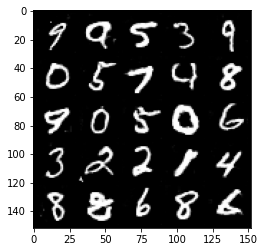

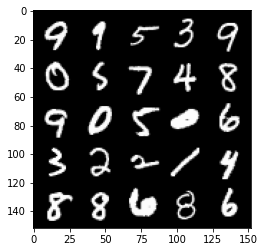

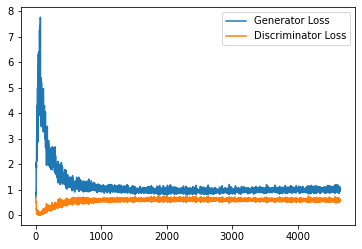

Epoch 199, step 93500: Generator loss: 1.005706955909729, discriminator loss: 0.5927810429930687


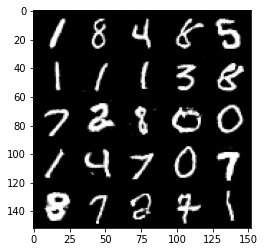

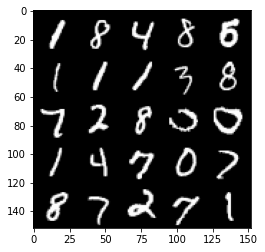

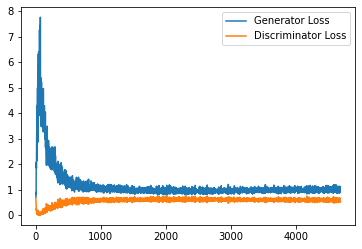

In [23]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [24]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

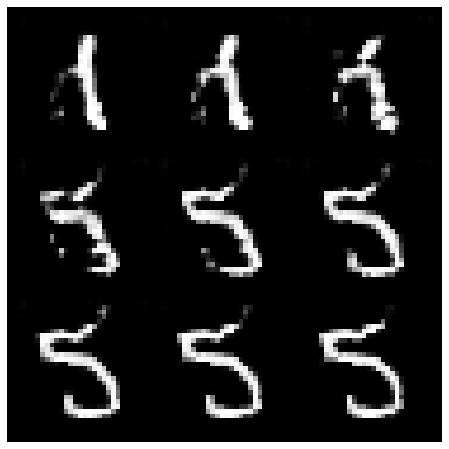

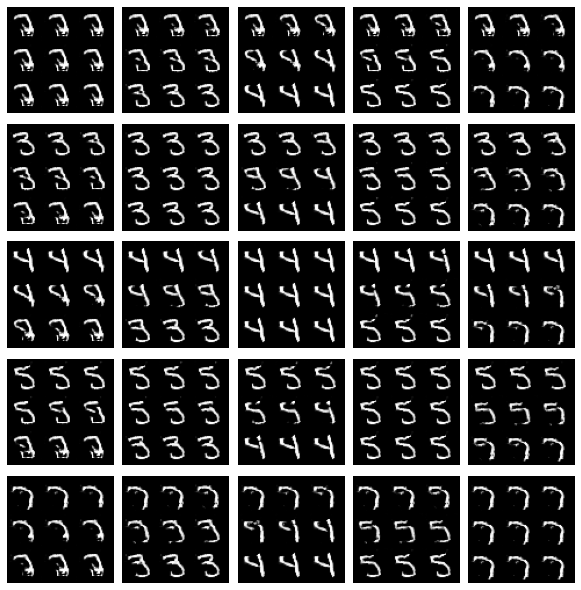

In [30]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)
    
    if first_number != 9:
        first_label = combine_vectors(first_label, torch.zeros(1, 9-first_number).long())
    if second_number != 9:
        second_label = combine_vectors(second_label, torch.zeros(1, 9-second_number).long())

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

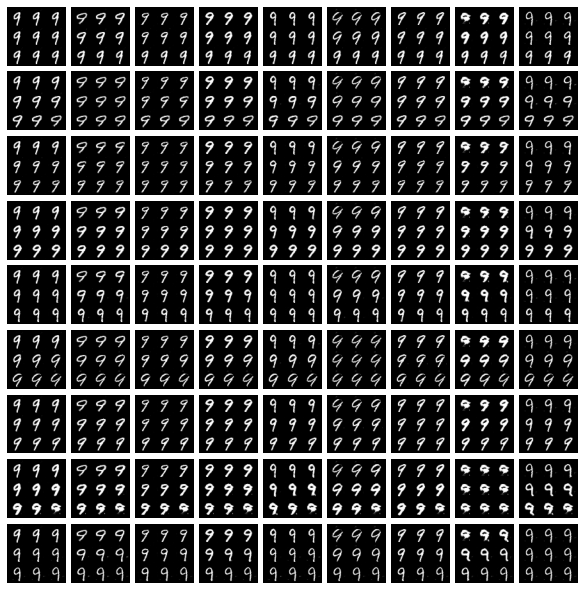

In [34]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([9]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 9 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()